# Prédire les Émissions de CO2 et la Consommation d'Énergie des Bâtiments      Non Destinés à l'Habitation


## Objectif de la Mission :

### Aider la ville de Seattle à atteindre son objectif de neutralité carbone en 2050 en développant un modèle de prédiction des émissions de CO2 et de la consommation d'énergie des bâtiments non destinés à l'habitation, en utilisant des données structurelles des bâtiments sans avoir besoin de relevés de consommation annuels futurs.



#

- Variable Target    : SiteEUIWN(kBtu/sf), GHGEmissionsIntensity

- Lignes et Colonnes : (3376, 46)

- Types de variables :  *float64    22 (47.83%)     
                        *object     15 (32.61%)
                        *int64       8 (17.39%)
                        *bool        1 (2.17%)

- Decription         :

- Analyse des NANs   : Le jeu ne contient pas énormement de valeurs manquantes soit 12,65 % de l'ensemble des cellules. Cependant, il existe 5 variables qui comptent plus de 80 % de valeurs manquantes.

- Outliers           : On remplace les Valeurs aberrantes par NANs qui nous servirons à l'étapes d'imputation.

## IMPORTATION

In [1]:
#Importation des bibliothèques
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
import seaborn as sns
import missingno as mno
import warnings
warnings.filterwarnings('ignore')

In [2]:
#Importation du jeu de donnée
data = pd.read_csv('2016_Building_Energy_Benchmarking.csv', low_memory=False)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_row', None)

#

# EXPLORATION

######

In [3]:
#Affichage du jeu de donnée
data

,OSEBuildingID,DataYear,BuildingType,PrimaryPropertyType,PropertyName,Address,City,State,ZipCode,TaxParcelIdentificationNumber,CouncilDistrictCode,Neighborhood,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,YearsENERGYSTARCertified,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),Electricity(kWh),Electricity(kBtu),NaturalGas(therms),NaturalGas(kBtu),DefaultData,Comments,ComplianceStatus,Outlier,TotalGHGEmissions,GHGEmissionsIntensity
0,1,2016,NonResidential,Hotel,Mayflower park hotel,405 Olive way,Seattle,WA,98101.0,0659000030,7,DOWNTOWN,47.612200,-122.337990,1927,1.0,12,88434,0,88434,Hotel,Hotel,88434.0,NaN,NaN,NaN,NaN,NaN,60.0,81.699997,84.300003,182.500000,189.000000,7.226362e+06,7.456910e+06,2.003882e+06,1.156514e+06,3.946027e+06,1.276453e+04,1.276453e+06,False,NaN,Compliant,NaN,249.98,2.83
1,2,2016,NonResidential,Hotel,Paramount Hotel,724 Pine street,Seattle,WA,98101.0,0659000220,7,DOWNTOWN,47.613170,-122.333930,1996,1.0,11,103566,15064,88502,"Hotel, Parking, Restaurant",Hotel,83880.0,Parking,15064.000000,Restaurant,4622.000000,NaN,61.0,94.800003,97.900002,176.100006,179.399994,8.387933e+06,8.664479e+06,0.000000e+00,9.504252e+05,3.242851e+06,5.145082e+04,5.145082e+06,False,NaN,Compliant,NaN,295.86,2.86
2,3,2016,NonResidential,Hotel,5673-The Westin Seattle,1900 5th Avenue,Seattle,WA,98101.0,0659000475,7,DOWNTOWN,47.613930,-122.338100,1969,1.0,41,956110,196718,759392,Hotel,Hotel,756493.0,NaN,NaN,NaN,NaN,NaN,43.0,96.000000,97.699997,241.899994,244.100006,7.258702e+07,7.393711e+07,2.156655e+07,1.451544e+07,4.952666e+07,1.493800e+04,1.493800e+06,False,NaN,Compliant,NaN,2089.28,2.19
3,5,2016,NonResidential,Hotel,HOTEL MAX,620 STEWART ST,Seattle,WA,98101.0,0659000640,7,DOWNTOWN,47.614120,-122.336640,1926,1.0,10,61320,0,61320,Hotel,Hotel,61320.0,NaN,NaN,NaN,NaN,NaN,56.0,110.800003,113.300003,216.199997,224.000000,6.794584e+06,6.946800e+06,2.214446e+06,8.115253e+05,2.768924e+06,1.811213e+04,1.811213e+06,False,NaN,Compliant,NaN,286.43,4.67
4,8,2016,NonResidential,Hotel,WARWICK SEATTLE HOTEL (ID8),401 LENORA ST,Seattle,WA,98121.0,0659000970,7,DOWNTOWN,47.613750,-122.340470,1980,1.0,18,175580,62000,113580,"Hotel, Parking, Swimming Pool",Hotel,123445.0,Parking,68009.000000,Swimming Pool,0.000000,NaN,75.0,114.800003,118.699997,211.399994,215.600006,1.417261e+07,1.465650e+07,0.000000e+00,1.573449e+06,5.368607e+06,8.803998e+04,8.803998e+06,False,NaN,Compliant,NaN,505.01,2.88
5,9,2016,Nonresidential COS,Other,West Precinct,810 Virginia St,Seattle,WA,98101.0,0660000560,7,DOWNTOWN,47.616230,-122.336570,1999,1.0,2,97288,37198,60090,Police Station,Police Station,88830.0,NaN,NaN,NaN,NaN,NaN,NaN,136.100006,141.600006,316.299988,320.500000,1.208662e+07,1.258171e+07,0.000000e+00,2.160444e+06,7.371434e+06,4.715182e+04,4.715182e+06,False,NaN,Compliant,NaN,301.81,3.10
6,10,2016,NonResidential,Hotel,Camlin,1619 9th Avenue,Seattle,WA,98101.0,0660000825,7,DOWNTOWN,47.613900,-122.332830,1926,1.0,11,83008,0,83008,Hotel,Hotel,81352.0,NaN,NaN,NaN,NaN,NaN,27.0,70.800003,74.500000,146.600006,154.699997,5.758795e+06,6.062768e+06,0.000000e+00,8.239199e+05,2.811215e+06,2.947580e+04,2.947580e+06,False,NaN,Compliant,NaN,176.14,2.12
7,11,2016,NonResidential,Other,Paramount Theatre,911 Pine St,Seattle,WA,98101.0,0660000955,7,DOWNTOWN,47.613270,-122.331360,1926,1.0,8,102761,0,102761,Other - Entertainment/Public Assembly,Other - Entertainment/Public Assembly,102761.0,NaN,NaN,NaN,NaN,NaN,NaN,61.299999,68.800003,141.699997,152.300003,6.298132e+06,7.067882e+06,2.276286e+06,1.065843e+06,3.636655e+06,3.851890e+03,3.851890e+05,False,NaN,Compliant,NaN,221.51,2.16
8,12,2016,NonResidential,Hotel,311wh-Pioneer Squa

In [4]:
data.Outlier.value_counts()

Low outlier     23
High outlier     9
Name: Outlier, dtype: int64

In [5]:
data.ComplianceStatus.value_counts()

Compliant                       3211
Error - Correct Default Data     113
Non-Compliant                     37
Missing Data                      15
Name: ComplianceStatus, dtype: int64

In [6]:
#Création d'une copie
df = data.copy()

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3376 entries, 0 to 3375
Data columns (total 46 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   OSEBuildingID                    3376 non-null   int64  
 1   DataYear                         3376 non-null   int64  
 2   BuildingType                     3376 non-null   object 
 3   PrimaryPropertyType              3376 non-null   object 
 4   PropertyName                     3376 non-null   object 
 5   Address                          3376 non-null   object 
 6   City                             3376 non-null   object 
 7   State                            3376 non-null   object 
 8   ZipCode                          3360 non-null   float64
 9   TaxParcelIdentificationNumber    3376 non-null   object 
 10  CouncilDistrictCode              3376 non-null   int64  
 11  Neighborhood                     3376 non-null   object 
 12  Latitude            

float64    22
object     15
int64       8
bool        1
dtype: int64


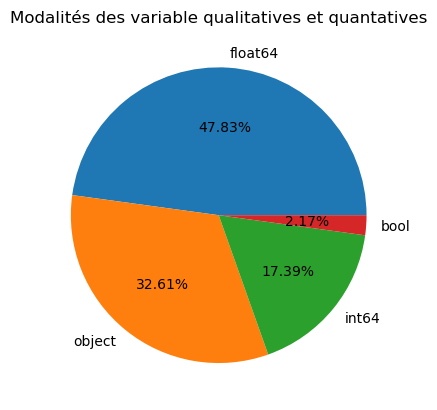

In [8]:
print(df.dtypes.value_counts())
df.dtypes.value_counts().plot.pie(autopct='%.2f%%')
plt.title('Modalités des variable qualitatives et quantatives')
pass

In [9]:
df.describe()

,OSEBuildingID,DataYear,ZipCode,CouncilDistrictCode,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),Electricity(kWh),Electricity(kBtu),NaturalGas(therms),NaturalGas(kBtu),Comments,TotalGHGEmissions,GHGEmissionsIntensity
count,3376.000000,3376.0,3360.000000,3376.000000,3376.000000,3376.000000,3376.000000,3368.000000,3376.000000,3.376000e+03,3376.000000,3.376000e+03,3.356000e+03,1679.000000,596.000000,2533.000000,3369.000000,3370.000000,3367.000000,3367.000000,3.371000e+03,3.370000e+03,3.367000e+03,3.367000e+03,3.367000e+03,3.367000e+03,3.367000e+03,0.0,3367.000000,3367.000000
mean,21208.991114,2016.0,98116.949107,4.439277,47.624033,-122.334795,1968.573164,1.106888,4.709123,9.483354e+04,8001.526066,8.683201e+04,7.917764e+04,28444.075817,11738.675166,67.918674,54.732116,57.033798,134.232848,137.783932,5.403667e+06,5.276726e+06,2.745959e+05,1.086639e+06,3.707612e+06,1.368505e+04,1.368505e+06,NaN,119.723971,1.175916
std,12223.757015,0.0,18.615205,2.120625,0.047758,0.027203,33.088156,2.108402,5.494465,2.188376e+05,32326.723928,2.079398e+05,2.017034e+05,54392.917928,29331.199286,26.873271,56.273124,57.163330,139.287554,139.109807,2.161063e+07,1.593879e+07,3.912173e+06,4.352478e+06,1.485066e+07,6.709781e+04,6.709781e+06,NaN,538.832227,1.821452
min,1.000000,2016.0,98006.000000,1.000000,47.499170,-122.414250,1900.000000,0.000000,0.000000,1.128500e+04,0.000000,3.636000e+03,5.656000e+03,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,-2.100000,0.000000e+00,0.000000e+00,0.000000e+00,-3.382680e+04,-1.154170e+05,0.000000e+00,0.000000e+00,NaN,-0.800000,-0.020000
25%,19990.750000,2016.0,98105.000000,3.000000,47.599860,-122.350662,1948.000000,1.000000,2.000000,2.848700e+04,0.000000,2.775600e+04,2.509475e+04,5000.000000,2239.000000,53.000000,27.900000,29.400000,74.699997,78.400002,9.251286e+05,9.701822e+05,0.000000e+00,1.874229e+05,6.394870e+05,0.000000e+00,0.000000e+00,NaN,9.495000,0.210000
50%,23112.000000,2016.0,98115.000000,4.000000,47.618675,-122.332495,1975.000000,1.000000,4.000000,4.417500e+04,0.000000,4.321600e+04,3.989400e+04,10664.000000,5043.000000,75.000000,38.599998,40.900002,96.199997,101.099998,1.803753e+06,1.904452e+06,0.000000e+00,3.451299e+05,1.177583e+06,3.237538e+03,3.237540e+05,NaN,33.920000,0.610000
75%,25994.250000,2016.0,98122.000000,7.000000,47.657115,-122.319407,1997.000000,1.000000,5.000000,9.099200e+04,0.000000,8.427625e+04,7.620025e+04,26640.000000,10138.750000,90.000000,60.400002,64.275002,143.899994,148.349998,4.222455e+06,4.381429e+06,0.000000e+00,8.293178e+05,2.829632e+06,1.189033e+04,1.189034e+06,NaN,93.940000,1.370000
max,50226.000000,2016.0,98272.000000,7.000000,47.733870,-122.220966,2015.000000,111.000000,99.000000,9.320156e+06,512608.000000,9.320156e+06,9.320156e+06,686750.000000,459748.000000,100.000000,834.400024,834.400024,2620.000000,2620.000000,8.739237e+08,4.716139e+08,1.349435e+08,1.925775e+08,6.570744e+08,2.979090e+06,2.979090e+08,NaN,16870.980000,34.090000


Total des valeurs non manquantes : 135344 soit 87.15 %
Total des valeurs manquantes : 19952 soit 12.85 %

Pourcentage de valeurs manquantes par variable:
OSEBuildingID                        0.0%
DataYear                             0.0%
BuildingType                         0.0%
PrimaryPropertyType                  0.0%
PropertyName                         0.0%
Address                              0.0%
City                                 0.0%
State                                0.0%
ZipCode                             0.47%
TaxParcelIdentificationNumber        0.0%
CouncilDistrictCode                  0.0%
Neighborhood                         0.0%
Latitude                             0.0%
Longitude                            0.0%
YearBuilt                            0.0%
NumberofBuildings                   0.24%
NumberofFloors                       0.0%
PropertyGFATotal                     0.0%
PropertyGFAParking                   0.0%
PropertyGFABuilding(s)               0.0%
ListOf

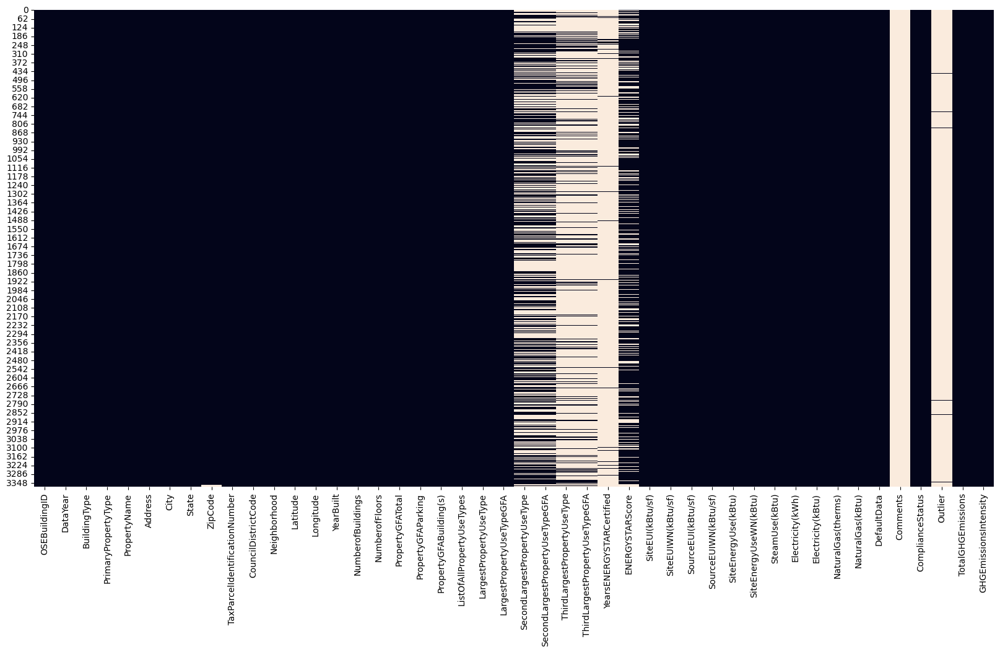

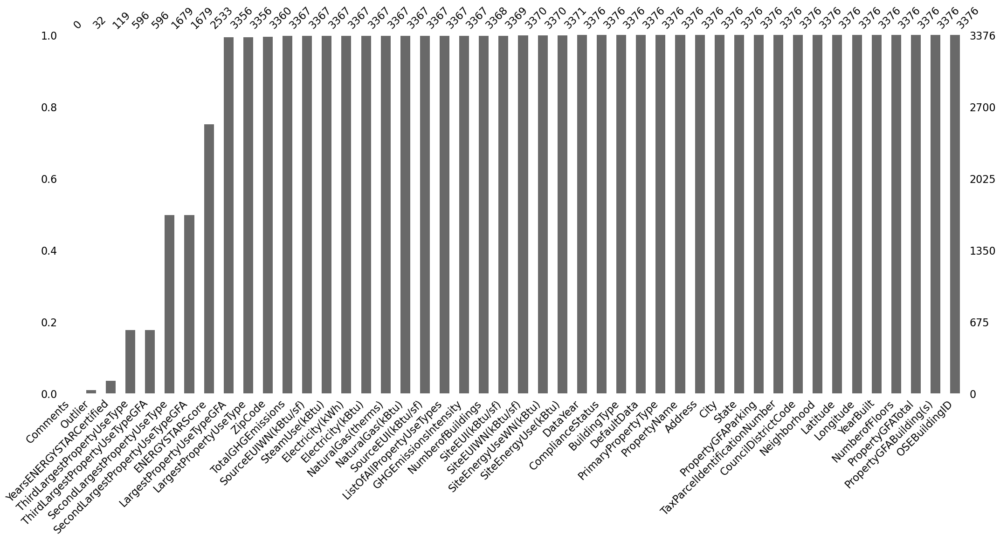

In [10]:
def valeurs_manquantes(df):
    # Identifier les valeurs manquantes
    missing_values = df.isnull().sum().sum()
    total_cells = df.size

    # Calculer le nombre de valeurs non manquantes
    non_missing_values = total_cells - missing_values

    # Calculer le pourcentage de valeurs non manquantes sur tout le jeu de données
    non_missing_percentage = (non_missing_values / total_cells) * 100

    # Calculer le pourcentage de valeurs manquantes sur tout le jeu de données
    missing_percentage = (missing_values / total_cells) * 100

    # Afficher les résultats
    print("Total des valeurs non manquantes :", non_missing_values, "soit", round(non_missing_percentage, 2), "%")
    print("Total des valeurs manquantes :", missing_values, "soit", round(missing_percentage, 2), "%")

    # Mesurer le prourcentage de NANs dans nos différentes colonnes
    missing_percentage_per_column = (df.isna().sum() / df.shape[0]) * 100
    print("\nPourcentage de valeurs manquantes par variable:")
    print(missing_percentage_per_column.apply(lambda x: f"{round(x, 2)}%"))

    # Affichage heatmap des valeurs manquantes
    plt.figure(figsize=(20, 10))
    ax = sns.heatmap(df.isna(), cbar=False)
    ax.set_title('')
    plt.show()

    # Barplot des valeurs manquantes
    mno.bar(df, sort="ascending")
    pass

#Affichage
valeurs_manquantes(df)


#### Sur le figure('heatmap'), tout ce qui est en blanc représante les valeurs manquantes.

In [11]:
def unique_values_per_variable(df):
    for col in df.columns:
        unique_values = df[col].unique()
        print(f"Unique values in '{col}': {unique_values}")


unique_values_per_variable(df)


Unique values in 'OSEBuildingID': [    1     2     3 ... 50224 50225 50226]
Unique values in 'DataYear': [2016]
Unique values in 'BuildingType': ['NonResidential' 'Nonresidential COS' 'Multifamily MR (5-9)'
 'SPS-District K-12' 'Campus' 'Multifamily LR (1-4)'
 'Multifamily HR (10+)' 'Nonresidential WA']
Unique values in 'PrimaryPropertyType': ['Hotel' 'Other' 'Mid-Rise Multifamily' 'Mixed Use Property' 'K-12 School'
 'University' 'Small- and Mid-Sized Office' 'Self-Storage Facility'
 'Warehouse' 'Large Office' 'Senior Care Community' 'Medical Office'
 'Retail Store' 'Hospital' 'Residence Hall' 'Distribution Center'
 'Worship Facility' 'Low-Rise Multifamily' 'Supermarket / Grocery Store'
 'Laboratory' 'Refrigerated Warehouse' 'Restaurant'
 'High-Rise Multifamily' 'Office']
Unique values in 'PropertyName': ['Mayflower park hotel' 'Paramount Hotel' '5673-The Westin Seattle' ...
 'Queen Anne Pool' 'South Park Community Center'
 'Van Asselt Community Center']
Unique values in 'Address': ['4

#

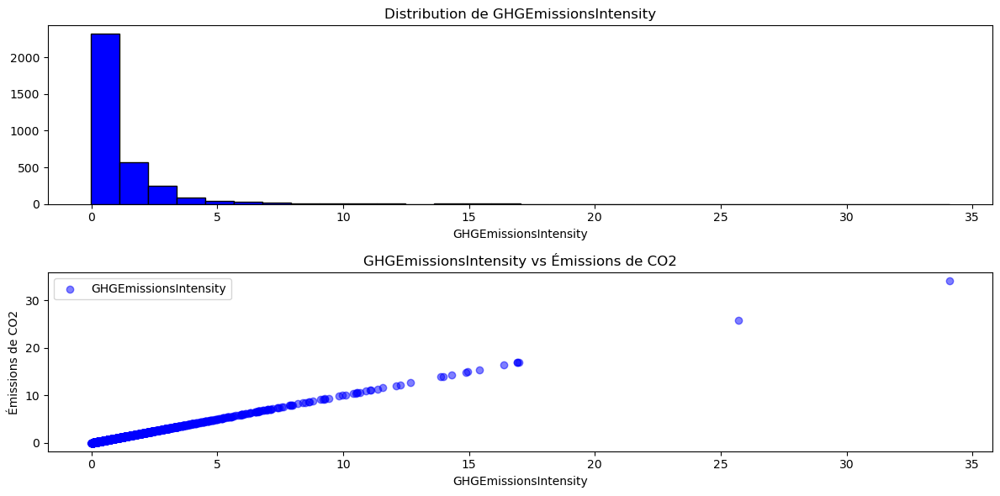

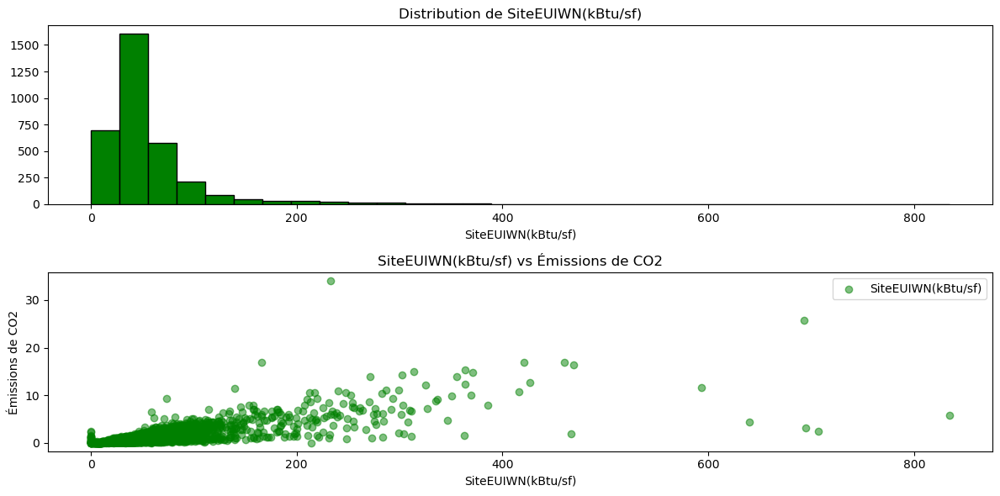

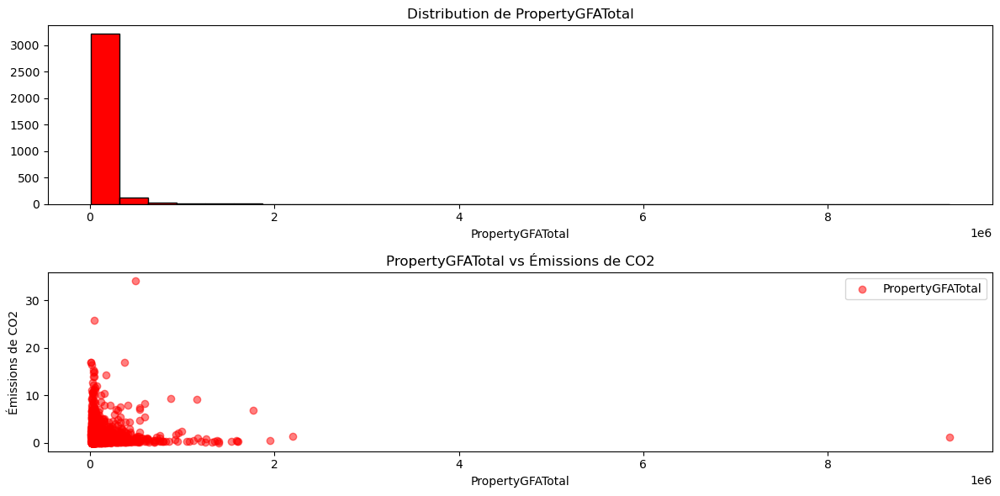

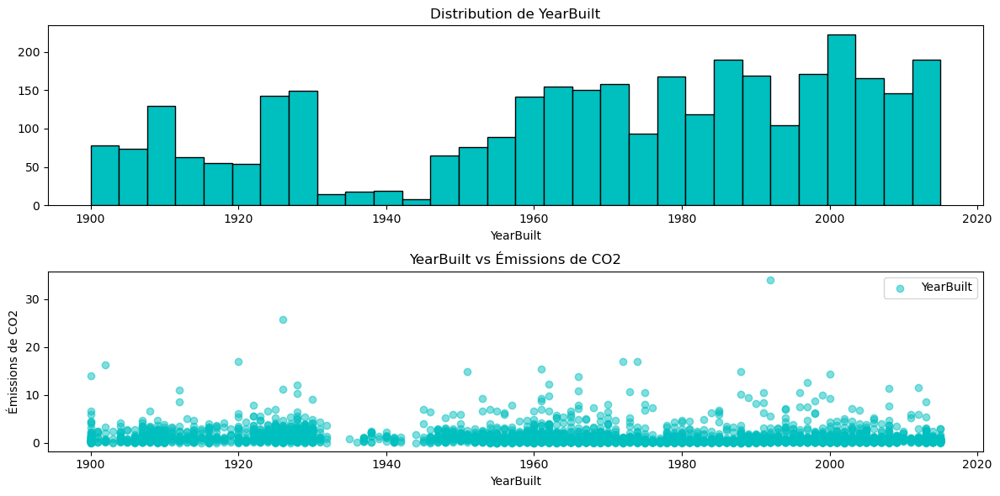

In [12]:
import matplotlib.pyplot as plt
import numpy as np

# Colonnes d'intérêt
cols_int = ['GHGEmissionsIntensity', 'SiteEUIWN(kBtu/sf)', 'PropertyGFATotal', 'YearBuilt']
colors = ['b', 'g', 'r', 'c'] 
# Créer une boucle pour générer les graphiques
for i, col in enumerate(cols_int):
    plt.figure(figsize=(12, 6))
    
    # Histogramme
    plt.subplot(2, 1, 1)
    plt.hist(data[col], bins=30, edgecolor="k", color=colors[i])
    plt.title(f"Distribution de {col}")
    plt.xlabel(col)
    
    # Graphique de dispersion
    plt.subplot(2, 1, 2)
    plt.scatter(data[col], data["GHGEmissionsIntensity"], alpha=0.5, color=colors[i], label=col)
    plt.title(f"{col} vs Émissions de CO2")
    plt.xlabel(col)
    plt.ylabel("Émissions de CO2")
    plt.legend()
    
    plt.tight_layout()
    plt.show()


# 

# NETTOYAGE DES DONNEES

#### On sélectionne uniquement les bâtiments non destinés à l'habitation.

In [ ]:
non_resi_data = data[data['BuildingType'].str.startswith('Non')]


In [14]:
non_resi_data.reset_index(drop=True, inplace=True)

####

In [15]:
print("Après avoir filtré sur les Building Non residentiel, il nous reste", non_resi_data.shape[0],'Lignes et',non_resi_data.shape[1],'colonnes')

Après avoir filtré sur les Building Non residentiel, il nous reste 1546 Lignes et 46 colonnes


In [16]:
#Affichage des doublons a partir de la variable 'OSEBuildingID' qui est un ID unique a chaque propriété
print('le jeu posséde:',df.duplicated(subset=['OSEBuildingID']).sum(),'doublons')

le jeu posséde: 0 doublons


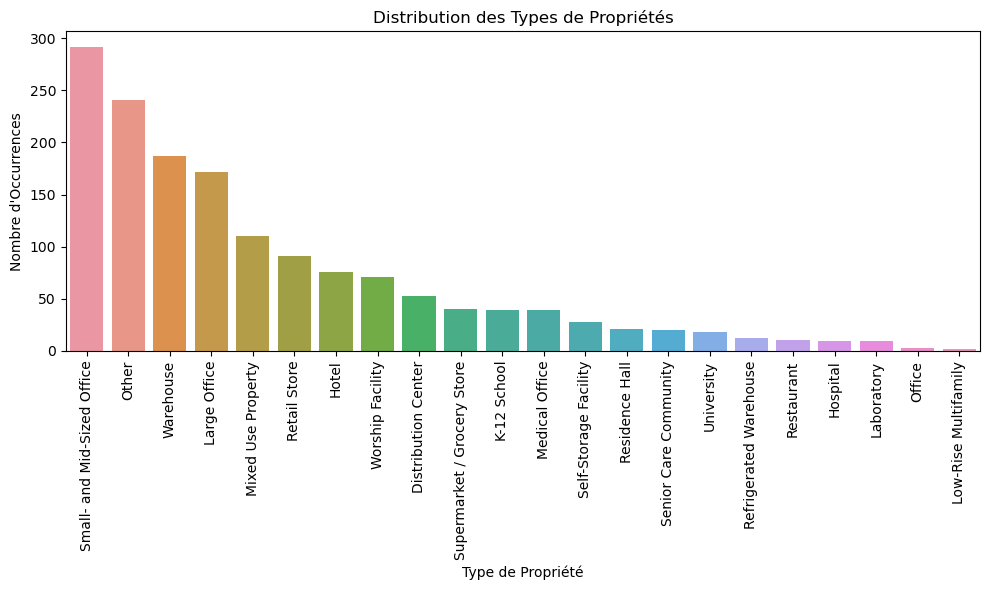

In [17]:
# Compter le nombre d'occurrences de chaque type de propriété
property_type_counts = non_resi_data['PrimaryPropertyType'].value_counts()

# Créer un graphique à barres pour la distribution des valeurs
plt.figure(figsize=(10, 6))
sns.barplot(x=property_type_counts.index, y=property_type_counts.values)
plt.xticks(rotation=90)
plt.xlabel('Type de Propriété')
plt.ylabel('Nombre d\'Occurrences')
plt.title('Distribution des Types de Propriétés')
plt.tight_layout()
plt.show()



#### Dans les colonnes des types de propriété (premier, second ou troisième), on peut parfois trouver la mention "multifamiliaux". Ces bâtiments sont parfois assimilés aux bâtiments commerciaux en raison de leur envergure et complexité similaires. Malgré leur usage résidentiel, leur conception partage des caractéristiques structurelles avec les édifices commerciaux en raison de leur nature polyvalente. Cette recherche adapte les meilleures pratiques de conception pour accroître l'efficacité énergétique et le confort de ces bâtiments multifamiliaux, comblant ainsi un manque dans les recommandations spécifiques à ce type de construction.

#### https://www.ashrae.org/news/ashraejournal/designing-low-to-mid-rise-multifamily-residential-buildings

In [18]:
# Vérifier et mettre à zéro 'SecondLargestPropertyUseTypeGFA' lorsque 'SecondLargestPropertyUseType' est NaN
non_resi_data.loc[non_resi_data['SecondLargestPropertyUseType'].isna(), 'SecondLargestPropertyUseTypeGFA'] = 0

# Vérifier et mettre à zéro 'ThirdLargestPropertyUseTypeGFA' lorsque 'ThirdLargestPropertyUseType' est NaN
non_resi_data.loc[non_resi_data['ThirdLargestPropertyUseType'].isna(), 'ThirdLargestPropertyUseTypeGFA'] = 0


#### On remplace par 0 les variables 'SecondLargestPropertyUseTypeGFA' et 'ThirdLargestPropertyUseTypeGFA' si elles ne sont pas utilisées, c'est-à-dire si les variables 'SecondLargestPropertyUseType' et 'ThirdLargestPropertyUseType' sont à NaN.

In [19]:
# On calcul la conso en métre carré 

# Conversion de kWh en kBtu (1 kWh ≈ 3.412 BTU)
non_resi_data['Electricity(kBtu)'] = non_resi_data['Electricity(kWh)'] * 3.412

# Liste des colonnes à  (y compris la conversion)
columns_a_ajuster = [
    'SiteEnergyUse(kBtu)', 'SiteEnergyUseWN(kBtu)',
    'SteamUse(kBtu)',
    'Electricity(kBtu)',
    'NaturalGas(therms)', 'NaturalGas(kBtu)',
    'TotalGHGEmissions'
]

# Ajuster en utilisant la surface du bâtiment (PropertyGFATotal)
for column in columns_a_ajuster:
    non_resi_data[column + '_per_sqf'] = non_resi_data[column] / non_resi_data['PropertyGFATotal']

# Maintenant, le DataFrame "data" contient les nouvelles colonnes au métre carré et converties
# Les noms des nouvelles colonnes sont dérivés des colonnes d'origine en ajoutant "_per_sqf"


In [20]:
non_resi_data.head()

,OSEBuildingID,DataYear,BuildingType,PrimaryPropertyType,PropertyName,Address,City,State,ZipCode,TaxParcelIdentificationNumber,CouncilDistrictCode,Neighborhood,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,YearsENERGYSTARCertified,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),Electricity(kWh),Electricity(kBtu),NaturalGas(therms),NaturalGas(kBtu),DefaultData,Comments,ComplianceStatus,Outlier,TotalGHGEmissions,GHGEmissionsIntensity,SiteEnergyUse(kBtu)_per_sqf,SiteEnergyUseWN(kBtu)_per_sqf,SteamUse(kBtu)_per_sqf,Electricity(kBtu)_per_sqf,NaturalGas(therms)_per_sqf,NaturalGas(kBtu)_per_sqf,TotalGHGEmissions_per_sqf
0,1,2016,NonResidential,Hotel,Mayflower park hotel,405 Olive way,Seattle,WA,98101.0,0659000030,7,DOWNTOWN,47.61220,-122.33799,1927,1.0,12,88434,0,88434,Hotel,Hotel,88434.0,NaN,0.0,NaN,0.0,NaN,60.0,81.699997,84.300003,182.500000,189.000000,7226362.5,7456910.0,2003882.00,1.156514e+06,3.946027e+06,12764.52930,1276453.0,False,NaN,Compliant,NaN,249.98,2.83,81.714753,84.321754,22.659633,44.621148,0.144340,14.433962,0.002827
1,2,2016,NonResidential,Hotel,Paramount Hotel,724 Pine street,Seattle,WA,98101.0,0659000220,7,DOWNTOWN,47.61317,-122.33393,1996,1.0,11,103566,15064,88502,"Hotel, Parking, Restaurant",Hotel,83880.0,Parking,15064.0,Restaurant,4622.0,NaN,61.0,94.800003,97.900002,176.100006,179.399994,8387933.0,8664479.0,0.00,9.504252e+05,3.242851e+06,51450.81641,5145082.0,False,NaN,Compliant,NaN,295.86,2.86,80.991184,83.661424,0.000000,31.311924,0.496793,49.679258,0.002857
2,3,2016,NonResidential,Hotel,5673-The Westin Seattle,1900 5th Avenue,Seattle,WA,98101.0,0659000475,7,DOWNTOWN,47.61393,-122.33810,1969,1.0,41,956110,196718,759392,Hotel,Hotel,756493.0,NaN,0.0,NaN,0.0,NaN,43.0,96.000000,97.699997,241.899994,244.100006,72587024.0,73937112.0,21566554.00,1.451544e+07,4.952666e+07,14938.00000,1493800.0,False,NaN,Compliant,NaN,2089.28,2.19,75.919114,77.331177,22.556561,51.800174,0.015624,1.562373,0.002185
3,5,2016,NonResidential,Hotel,HOTEL MAX,620 STEWART ST,Seattle,WA,98101.0,0659000640,7,DOWNTOWN,47.61412,-122.33664,1926,1.0,10,61320,0,61320,Hotel,Hotel,61320.0,NaN,0.0,NaN,0.0,NaN,56.0,110.800003,113.300003,216.199997,224.000000,6794584.0,6946800.5,2214446.25,8.115253e+05,2.768924e+06,18112.13086,1811213.0,False,NaN,Compliant,NaN,286.43,4.67,110.805349,113.287679,36.112953,45.155322,0.295371,29.537068,0.004671
4,8,2016,NonResidential,Hotel,WARWICK SEATTLE HOTEL (ID8),401 LENORA ST,Seattle,WA,98121.0,0659000970,7,DOWNTOWN,47.61375,-122.34047,1980,1.0,18,175580,62000,113580,"Hotel, Parking, Swimming Pool",Hotel,123445.0,Parking,68009.0,Swimming Pool,0.0,NaN,75.0,114.800003,118.699997,211.399994,215.600006,14172606.0,14656503.0,0.00,1.573449e+06,5.368607e+06,88039.98438,8803998.0,False,NaN,Compliant,NaN,505.01,2.88,80.718795,83.474786,0.000000,30.576414,0.501424,50.142374,0.002876


In [21]:
#Suppression des colonnes inutiles 
non_resi_data = non_resi_data.drop(['OSEBuildingID','City', 'State', 'ZipCode', 'TaxParcelIdentificationNumber',
                                    'PropertyName','Address','YearsENERGYSTARCertified','Comments','DefaultData',
                                    'ListOfAllPropertyUseTypes','BuildingType', 'SiteEnergyUse(kBtu)',  
                                    'LargestPropertyUseType', 'SecondLargestPropertyUseType', 'ThirdLargestPropertyUseType',
                                    'SiteEnergyUseWN(kBtu)', 'SteamUse(kBtu)', 'Electricity(kBtu)', 'NaturalGas(therms)', 
                                    'NaturalGas(kBtu)', 'TotalGHGEmissions','Electricity(kWh)', 'SiteEUI(kBtu/sf)','TotalGHGEmissions' ], axis=1)

In [22]:
non_resi_data['ComplianceStatus'].value_counts()

Compliant                       1514
Non-Compliant                     18
Error - Correct Default Data      13
Missing Data                       1
Name: ComplianceStatus, dtype: int64

In [23]:
non_resi_data.Outlier.unique()

array([nan, 'High outlier', 'Low outlier'], dtype=object)

#### FILTRE

In [24]:
# Classe personnalisée pour filtrer les lignes avec 'Outlier' non NaN
class FilterOutliers(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        return X[X['Outlier'].isna()]

# Charger vos données dans un DataFrame non_resi_data

# Créer le pipeline
pipeline = Pipeline([
    ('filter_outliers', FilterOutliers())
])

# Appliquer la première transformation (filtre d'outliers)
non_resi_data_filtered_outliers = pipeline.fit_transform(non_resi_data)

# Filtrer les lignes où 'ComplianceStatus' est égal à 'Compliant'
non_resi_data_filtered = non_resi_data_filtered_outliers[non_resi_data_filtered_outliers['ComplianceStatus'] == 'Compliant']

# Supprimer les colonnes du DataFrame non_resi_data_filtered
columns_to_drop = ['Outlier', 'ComplianceStatus']  
non_resi_data = non_resi_data_filtered.drop(columns=columns_to_drop)


In [25]:
non_resi_data.head()

,DataYear,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),GHGEmissionsIntensity,SiteEnergyUse(kBtu)_per_sqf,SiteEnergyUseWN(kBtu)_per_sqf,SteamUse(kBtu)_per_sqf,Electricity(kBtu)_per_sqf,NaturalGas(therms)_per_sqf,NaturalGas(kBtu)_per_sqf,TotalGHGEmissions_per_sqf
0,2016,Hotel,7,DOWNTOWN,47.61220,-122.33799,1927,1.0,12,88434,0,88434,88434.0,0.0,0.0,60.0,84.300003,182.500000,189.000000,2.83,81.714753,84.321754,22.659633,44.621148,0.144340,14.433962,0.002827
1,2016,Hotel,7,DOWNTOWN,47.61317,-122.33393,1996,1.0,11,103566,15064,88502,83880.0,15064.0,4622.0,61.0,97.900002,176.100006,179.399994,2.86,80.991184,83.661424,0.000000,31.311924,0.496793,49.679258,0.002857
2,2016,Hotel,7,DOWNTOWN,47.61393,-122.33810,1969,1.0,41,956110,196718,759392,756493.0,0.0,0.0,43.0,97.699997,241.899994,244.100006,2.19,75.919114,77.331177,22.556561,51.800174,0.015624,1.562373,0.002185
3,2016,Hotel,7,DOWNTOWN,47.61412,-122.33664,1926,1.0,10,61320,0,61320,61320.0,0.0,0.0,56.0,113.300003,216.199997,224.000000,4.67,110.805349,113.287679,36.112953,45.155322,0.295371,29.537068,0.004671
4,2016,Hotel,7,DOWNTOWN,47.61375,-122.34047,1980,1.0,18,175580,62000,113580,123445.0,68009.0,0.0,75.0,118.699997,211.399994,215.600006,2.88,80.718795,83.474786,0.000000,30.576414,0.501424,50.142374,0.002876


#### Comme la plupart de nos variables sont mesurées en milliers d'unités thermiques britanniques (kBtu), et que certaines variables sont également mesurées en kilowatts-heures (kWh) ou  mesurée en thermes et qu'elles sont redondantes avec des variable mesures en kBtu, nous allons donc les supprimer."Etant donnée qu'elles sont corrélées entre elles et n'apportent pas d'informations distinctes. Cela peut entraîner des problèmes de complexité inutile, de temps de calcul accumulé et de sur-ajustement dans les analyses et les modèles.


In [26]:
#Transformation des valeurs minuscule en majuscule pour la colonne du voisinage
non_resi_data['Neighborhood'] = non_resi_data['Neighborhood'].str.upper()

In [27]:
non_resi_data.Neighborhood.unique()

array(['DOWNTOWN', 'NORTHEAST', 'EAST', 'LAKE UNION', 'GREATER DUWAMISH',
       'BALLARD', 'NORTHWEST', 'MAGNOLIA / QUEEN ANNE', 'CENTRAL',
       'SOUTHWEST', 'SOUTHEAST', 'NORTH', 'DELRIDGE',
       'DELRIDGE NEIGHBORHOODS'], dtype=object)

In [28]:
# Nombre de lignes et de colonnes restantes
original_num_rows = data.shape[0]
original_num_cols = data.shape[1]
num_rows = non_resi_data.shape[0]
num_cols = non_resi_data.shape[1]

# Calcul du pourcentage de lignes et de colonnes restantes par rapport au jeu de données initial
percent_rows = (num_rows / original_num_rows) * 100
percent_cols = (num_cols / original_num_cols) * 100

# Affichage des résultats pour le jeu de données initial
print("Jeu de données initial :")
print("Nombre de lignes :", original_num_rows)
print("Nombre de colonnes :", original_num_cols)

# Affichage des résultats après la suppression des doublons et des colonnes inutiles
print("\nAprès la suppression des doublons et des colonnes inutiles :")
print("Nombre de lignes restantes :", num_rows)
print("Nombre de colonnes restantes :", num_cols)

# Affichage des pourcentages
print("\nPourcentage de lignes restantes :", round(percent_rows, 2), "%")
print("Pourcentage de colonnes restantes :", round(percent_cols, 2), "%")


Jeu de données initial :
Nombre de lignes : 3376
Nombre de colonnes : 46

Après la suppression des doublons et des colonnes inutiles :
Nombre de lignes restantes : 1514
Nombre de colonnes restantes : 27

Pourcentage de lignes restantes : 44.85 %
Pourcentage de colonnes restantes : 58.7 %


##### 

In [29]:
non_resi_data.isna().sum().sum()

536

In [30]:
non_resi_data[non_resi_data['NumberofFloors'] == 0]

,DataYear,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),GHGEmissionsIntensity,SiteEnergyUse(kBtu)_per_sqf,SiteEnergyUseWN(kBtu)_per_sqf,SteamUse(kBtu)_per_sqf,Electricity(kBtu)_per_sqf,NaturalGas(therms)_per_sqf,NaturalGas(kBtu)_per_sqf,TotalGHGEmissions_per_sqf
122,2016,Hotel,7,DOWNTOWN,47.61275,-122.33330,1999,1.0,0,934292,0,934292,495536.0,438756.0,49700.0,NaN,120.500000,272.899994,278.200012,1.75,69.622007,71.179927,0.000000,42.132561,0.274894,27.489438,0.001754
425,2016,Medical Office,3,EAST,47.60979,-122.32298,2004,1.0,0,225982,0,225982,200184.0,0.0,0.0,53.0,103.699997,246.899994,245.300003,3.06,90.983450,91.887026,34.585334,56.398107,0.000000,0.000000,0.003063
426,2016,Mixed Use Property,7,DOWNTOWN,47.61783,-122.33729,2006,0.0,0,516407,0,516407,385196.0,340236.0,67627.0,31.0,78.900002,199.199997,202.000000,1.42,76.302839,78.919077,0.000000,56.995359,0.193075,19.307469,0.001423
499,2016,Other,7,DOWNTOWN,47.61289,-122.33531,1999,1.0,0,947987,0,947987,561684.0,100000.0,80000.0,NaN,62.099998,195.600006,194.899994,0.34,49.062867,48.886012,0.000000,49.062861,0.000000,0.000000,0.000342
988,2016,Medical Office,3,EAST,47.60862,-122.32372,1945,1.0,0,274568,0,274568,228133.0,135954.0,0.0,52.0,111.199997,235.500000,233.100006,4.04,92.186730,92.356436,48.426069,43.760654,0.000000,0.000000,0.004043
1454,2016,Warehouse,4,NORTHEAST,47.68454,-122.26235,1940,1.0,0,384772,0,384772,349953.0,63872.0,0.0,69.0,39.000000,84.099998,86.500000,1.02,39.521488,41.945768,0.000000,23.429128,0.160924,16.092356,0.001018
1455,2016,Medical Office,4,NORTHEAST,47.68240,-122.26223,1960,1.0,0,30287,0,30287,28050.0,0.0,0.0,32.0,81.300003,217.399994,220.600006,1.08,72.411100,75.267689,0.000000,59.940064,0.124710,12.471027,0.001080
1456,2016,Small- and Mid-Sized Office,4,NORTHEAST,47.68254,-122.26299,1960,1.0,0,21931,0,21931,31845.0,31845.0,0.0,32.0,134.800003,221.899994,233.300003,6.62,179.983095,195.714559,0.000000,63.772320,1.162108,116.210798,0.006617
1470,2016,Other,4,NORTHEAST,47.68212,-122.26330,1929,8.0,0,502030,0,502030,564258.0,0.0,0.0,NaN,36.599998,69.000000,74.300003,1.09,36.791307,41.178710,0.000000,18.644072,0.181472,18.147232,0.001094
1505,2016,Other,2,SOUTHEAST,47.56260,-122.29396,2009,1.0,0,40265,0,40265,40265.0,0.0,0.0,NaN,56.200001,127.500000,130.199997,1.28,53.623997,56.154862,0.000000,34.066885,0.195571,19.557109,0.001276


In [31]:
non_resi_data[non_resi_data['NumberofBuildings'] == 0]


,DataYear,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),GHGEmissionsIntensity,SiteEnergyUse(kBtu)_per_sqf,SiteEnergyUseWN(kBtu)_per_sqf,SteamUse(kBtu)_per_sqf,Electricity(kBtu)_per_sqf,NaturalGas(therms)_per_sqf,NaturalGas(kBtu)_per_sqf,TotalGHGEmissions_per_sqf
54,2016,Medical Office,3,EAST,47.612440,-122.321400,1965,0.0,3,179014,0,179014,179014.0,0.0,0.0,48.0,92.300003,213.399994,210.300003,2.41,93.294686,92.326360,0.000000,55.227435,0.380672,38.067246,0.002407
67,2016,Small- and Mid-Sized Office,7,MAGNOLIA / QUEEN ANNE,47.623910,-122.348370,1986,0.0,2,66240,2352,63888,45900.0,5181.0,4551.0,NaN,75.400002,235.199997,236.600006,0.44,62.897135,63.286651,0.000000,62.897122,0.000000,0.000000,0.000438
119,2016,Warehouse,1,GREATER DUWAMISH,47.575070,-122.357470,1916,0.0,4,79600,0,79600,79600.0,0.0,0.0,34.0,30.299999,95.099998,95.099998,0.21,30.293998,30.293998,0.000000,30.293995,0.000000,0.000000,0.000211
143,2016,Large Office,7,DOWNTOWN,47.617570,-122.351220,1968,0.0,3,100734,26731,74003,100734.0,0.0,0.0,20.0,98.199997,305.100006,308.399994,0.68,97.173913,98.204837,0.000000,97.173902,0.000000,0.000000,0.000677
183,2016,Small- and Mid-Sized Office,4,NORTHEAST,47.661000,-122.316260,1961,0.0,5,99005,0,99005,79555.0,0.0,0.0,70.0,63.000000,137.600006,140.699997,1.20,47.760098,50.584551,0.000000,28.919868,0.188402,18.840230,0.001202
206,2016,Mixed Use Property,2,GREATER DUWAMISH,47.528710,-122.294430,1970,0.0,1,88400,0,88400,33450.0,29620.0,27715.0,42.0,53.000000,109.000000,113.900002,1.31,49.582585,54.425339,0.000000,28.627351,0.209552,20.955226,0.001313
220,2016,Large Office,7,DOWNTOWN,47.610050,-122.336100,1926,0.0,10,132326,0,132326,92006.0,12610.0,9835.0,72.0,53.700001,159.800003,163.000000,0.49,45.561870,46.451124,2.480594,43.061993,0.000193,0.019278,0.000493
222,2016,Hotel,7,DOWNTOWN,47.609960,-122.335720,1973,0.0,19,332067,59280,272787,332067.0,0.0,0.0,6.0,114.400002,251.300003,249.300003,4.42,113.788940,114.387000,46.936353,59.628154,0.072244,7.224431,0.004422
232,2016,Other,7,DOWNTOWN,47.611850,-122.334210,1996,0.0,4,267335,166960,100375,166960.0,69947.0,27400.0,NaN,75.800003,189.399994,188.000000,0.55,27.206148,27.599905,0.000000,19.338664,0.078675,7.867481,0.000553
297,2016,Other,1,DELRIDGE,47.565480,-122.353780,1955,0.0,1,113780,0,113780,91532.0,22248.0,0.0,NaN,35.299999,60.000000,64.099998,1.07,31.416262,35.347768,0.000000,12.927446,0.184888,18.488812,0.001072


In [32]:
# Remplacer les valeurs 0 par NaN dans les colonnes "NumberofFloors" et "NumberofBuildings"
columns_to_replace = ["NumberofFloors", "NumberofBuildings"]
non_resi_data[columns_to_replace] = non_resi_data[columns_to_replace].replace(0, np.nan)

#### On s'est rendu compte que les colonnes "NumberofFloors" et "NumberofBuildings" contiennent des valeurs égales à 0. Après avoir approfondi notre recherche, nous avons confirmé qu'il s'agissait d'une erreur. Par conséquent, nous avons décidé de remplacer ces valeurs 0 par NaN afin de les inclure dans le processus d'imputation.

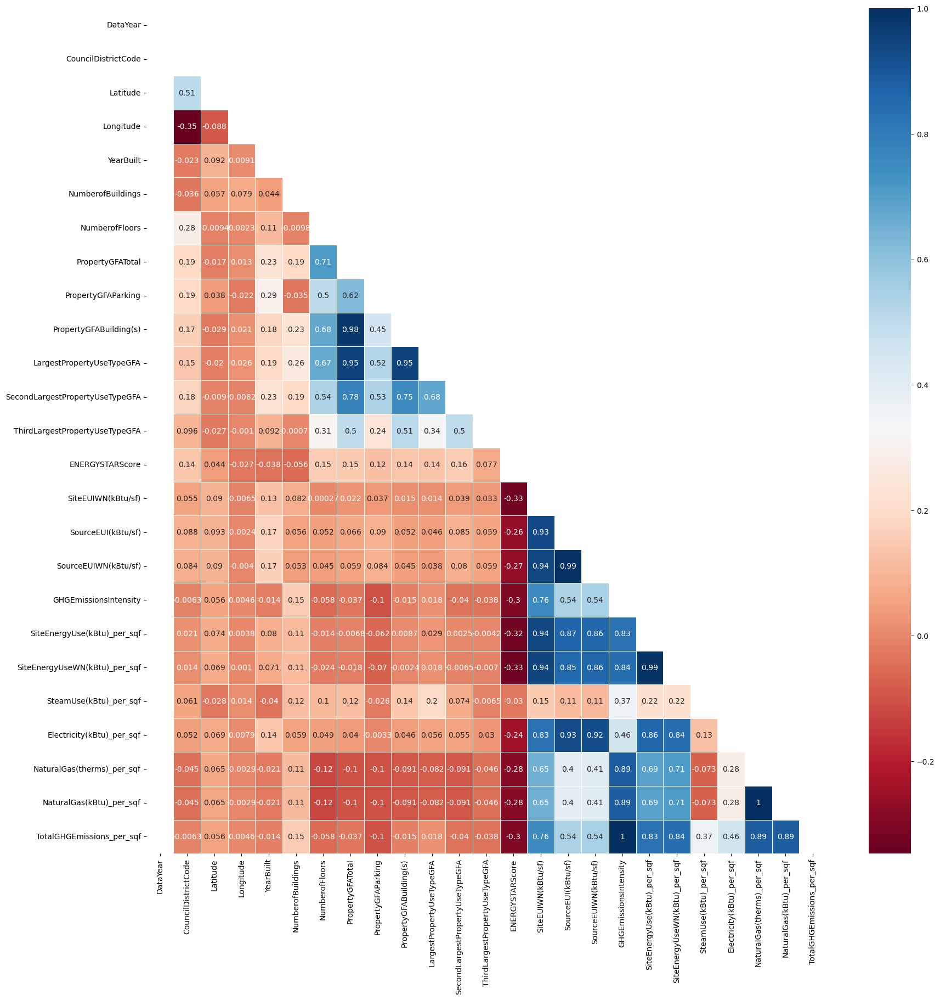

In [33]:
plt.figure(figsize=(20, 20))
mask = np.triu(np.ones_like(non_resi_data.corr()))
sns.heatmap(non_resi_data.corr(), cmap='RdBu' ,annot=True,mask=mask, linewidths=.5)
pass

# 

In [34]:
df_outlier = non_resi_data.copy()

# OUTLIER

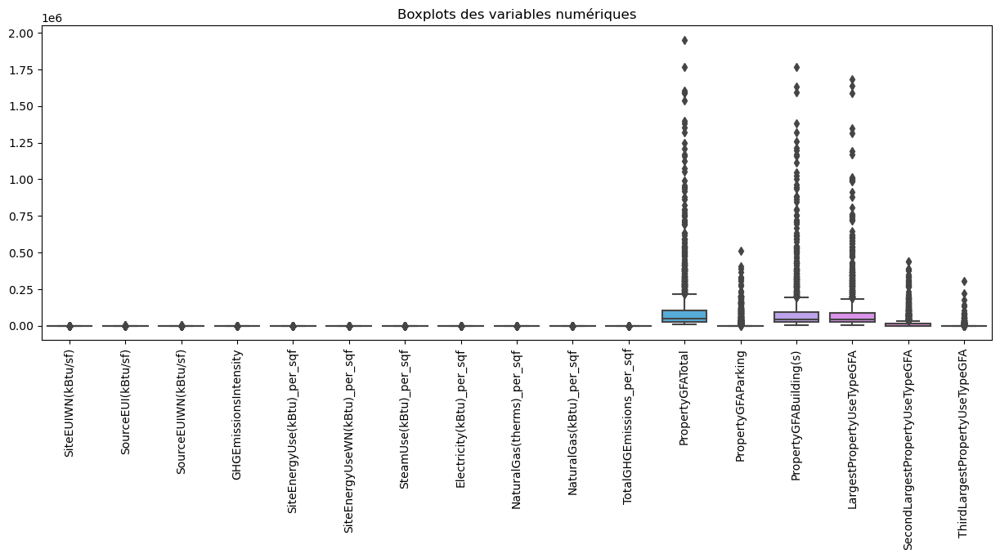

Trois valeurs les plus élevées de SiteEUIWN(kBtu/sf):
182     834.400024
249     707.299988
1483    694.700012
Name: SiteEUIWN(kBtu/sf), dtype: float64
Trois valeurs les plus élevées de SourceEUI(kBtu/sf):
182     2620.000000
249     2217.800049
1483    2181.300049
Name: SourceEUI(kBtu/sf), dtype: float64
Trois valeurs les plus élevées de SourceEUIWN(kBtu/sf):
182     2620.000000
249     2217.800049
1483    2181.300049
Name: SourceEUIWN(kBtu/sf), dtype: float64
Trois valeurs les plus élevées de GHGEmissionsIntensity:
627     25.71
1543    16.99
1535    16.93
Name: GHGEmissionsIntensity, dtype: float64
Trois valeurs les plus élevées de SiteEnergyUse(kBtu)_per_sqf:
182    834.402500
627    675.514427
493    639.680973
Name: SiteEnergyUse(kBtu)_per_sqf, dtype: float64
Trois valeurs les plus élevées de SiteEnergyUseWN(kBtu)_per_sqf:
182    834.402500
627    671.943227
493    639.782918
Name: SiteEnergyUseWN(kBtu)_per_sqf, dtype: float64
Trois valeurs les plus élevées de SteamUse(kBtu)_per_

In [35]:
def plot_numerical_boxplots(data_frame, columns):
    """
    Crée un graphique de boîte (boxplot) pour les variables numériques spécifiées dans un DataFrame.
    
    Args:
        data_frame (pd.DataFrame): Le DataFrame contenant les données.
        columns (list): Liste des noms de colonnes à inclure dans les boxplots.
    """
    # Sélectionner les colonnes numériques spécifiées
    num_var = data_frame[columns]

    # Créer la figure et les axes
    plt.figure(figsize=(15, 5))

    # Créer un graphique de type boîte (boxplot) pour les variables sélectionnées
    sns.boxplot(data=num_var)

    # Ajuster les angles des étiquettes sur l'axe x
    plt.xticks(rotation=90)

    # Ajouter un titre
    plt.title('Boxplots des variables numériques')

    # Afficher le graphique
    plt.show()

# Colonnes numériques d'intérêt
num_columns_of_interest = ['SiteEUIWN(kBtu/sf)','SourceEUI(kBtu/sf)','SourceEUIWN(kBtu/sf)','GHGEmissionsIntensity',
                           'SiteEnergyUse(kBtu)_per_sqf','SiteEnergyUseWN(kBtu)_per_sqf','SteamUse(kBtu)_per_sqf',
                           'Electricity(kBtu)_per_sqf','NaturalGas(therms)_per_sqf','NaturalGas(kBtu)_per_sqf',
                           'TotalGHGEmissions_per_sqf', 'PropertyGFATotal','PropertyGFAParking','PropertyGFABuilding(s)',
                           'LargestPropertyUseTypeGFA','SecondLargestPropertyUseTypeGFA','ThirdLargestPropertyUseTypeGFA']

# Utiliser la fonction pour créer les boxplots
plot_numerical_boxplots(df_outlier, num_columns_of_interest)


# Afficher les trois valeurs les plus élevées de chaque variable en dehors de la fonction
for column in num_columns_of_interest:
    top_3_max_values = df_outlier[column].nlargest(3)
    print(f"Trois valeurs les plus élevées de {column}:\n{top_3_max_values}")

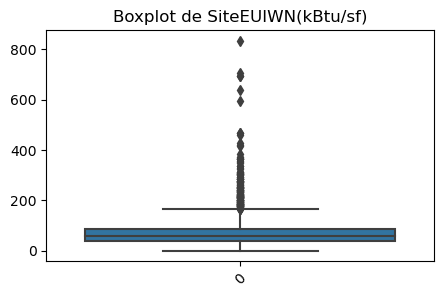

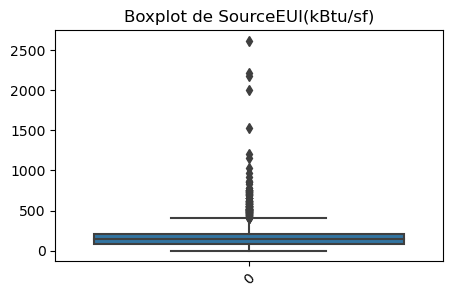

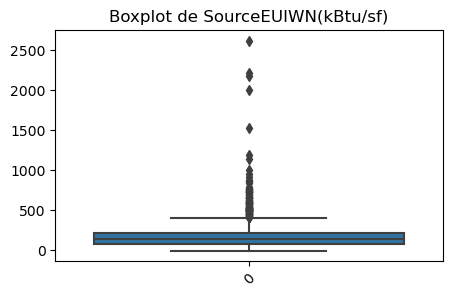

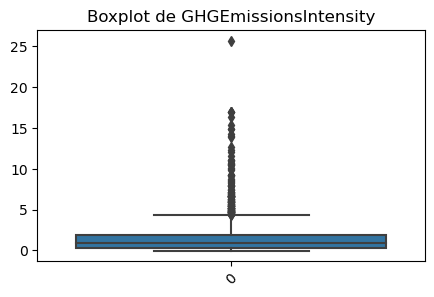

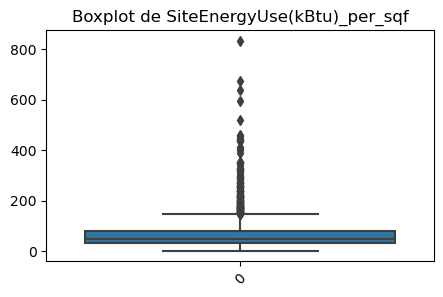

...

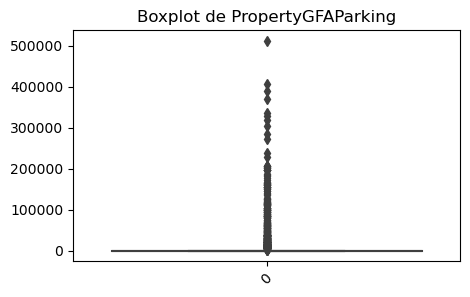

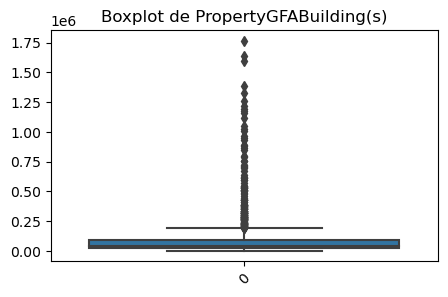

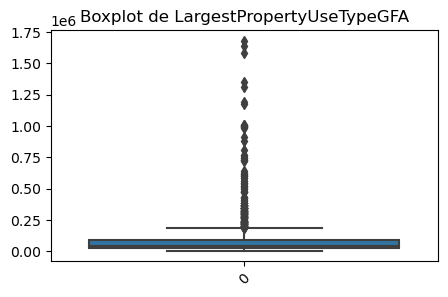

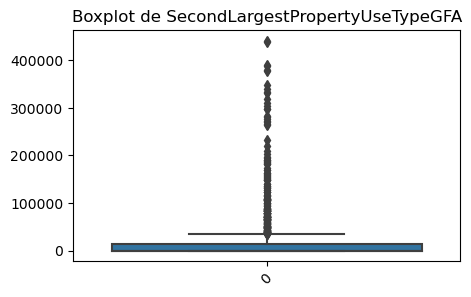

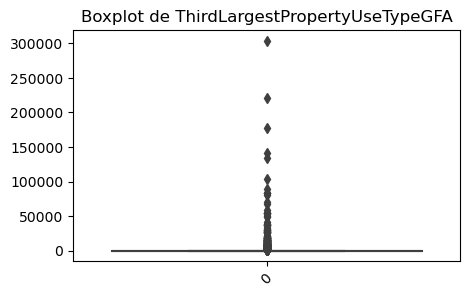

In [36]:
def plot_individual_boxplots(data_frame, columns):
    
    # Créer les boxplots individuels pour chaque colonne
    for col in columns:
        plt.figure(figsize=(5, 3))
        sns.boxplot(data=data_frame[col])
        plt.title(f'Boxplot de {col}')
        plt.xticks(rotation=45)
        plt.show()



# Utiliser la fonction pour créer les boxplots individuels
plot_individual_boxplots(df_outlier, num_columns_of_interest)


<Figure size 1500x500 with 0 Axes>

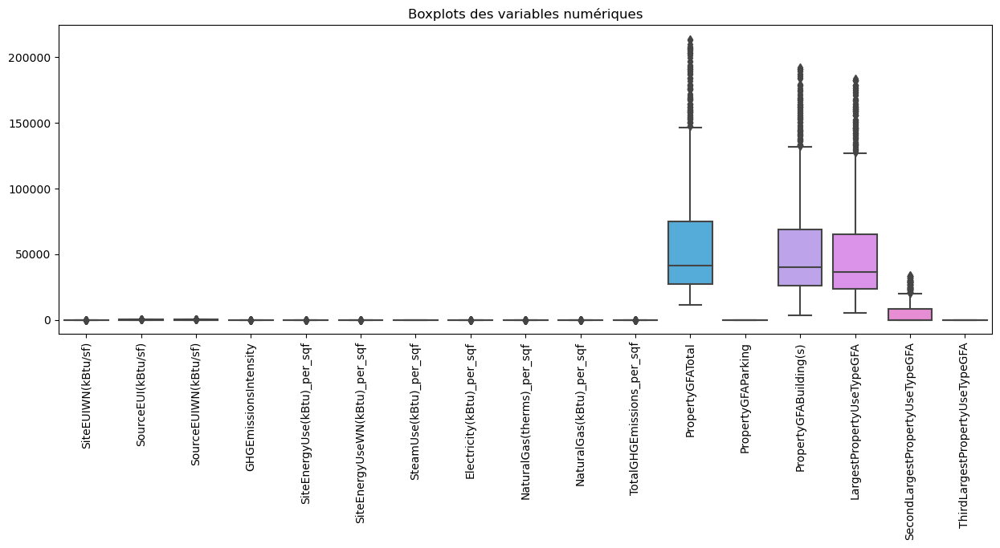

In [37]:
# Fonction pour appliquer le traitement IQR aux valeurs aberrantes
def iqr_func(x, lower_limit, upper_limit):
    if x < lower_limit or x > upper_limit:
        return np.nan
    return x

# Appliquer le traitement IQR aux colonnes sélectionnées
for col in num_columns_of_interest:
    Q1 = df_outlier[col].quantile(0.25)
    Q3 = df_outlier[col].quantile(0.75)
    IQR = Q3 - Q1

    lower = Q1 - 1.5 * IQR
    upper = Q3 + 1.5 * IQR

    df_outlier[col] = df_outlier[col].apply(lambda x: iqr_func(x, lower, upper))

# Utiliser la fonction pour créer les boxplots après le traitement IQR
plt.figure(figsize=(15, 5))
plot_numerical_boxplots(df_outlier, num_columns_of_interest)


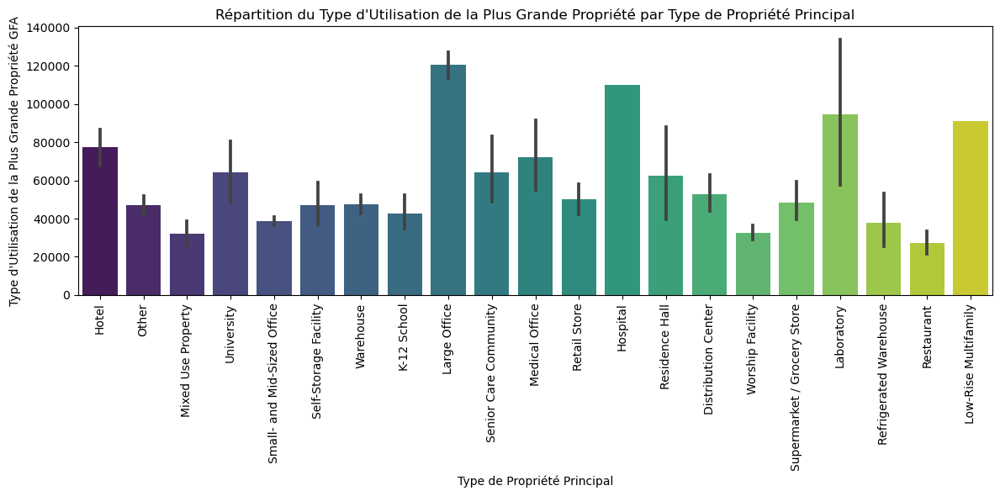

In [38]:
import seaborn as sns
import matplotlib.pyplot as plt

# Créez un graphique à barres pour la répartition du Type d'Utilisation de la Plus Grande Propriété en fonction du Type de Propriété Principal
plt.figure(figsize=(12, 6))
sns.barplot(x='PrimaryPropertyType', y='LargestPropertyUseTypeGFA', data=df_outlier, palette='viridis')
plt.xticks(rotation=90)  
plt.xlabel('Type de Propriété Principal')
plt.ylabel('Type d\'Utilisation de la Plus Grande Propriété GFA')
plt.title('Répartition du Type d\'Utilisation de la Plus Grande Propriété par Type de Propriété Principal')
plt.tight_layout()
plt.show()


In [39]:
df_outlier.shape

(1514, 27)

In [83]:
# Nombre d'observations dans le DataFrame original
total_data = data.shape[0]

# Nombre d'observations après avoir retiré les outliers
remaining_data = df_outlier.shape[0]

# Calcul du pourcentage
percentage_remaining = (remaining_data / total_data) * 100

# Affichage
print(f"Nombre d'observations total : {total_data}")
print(f"Nombre d'observations restant après avoir retiré les outliers : {remaining_data}")
print(f"Pourcentage d'observations restantes : {percentage_remaining:.2f}%")


Nombre d'observations total : 3376
Nombre d'observations restant après avoir retiré les outliers : 1514
Pourcentage d'observations restantes : 44.85%


In [40]:
df_impu = df_outlier.copy()
df_impu.reset_index(drop=True, inplace=True)

### 

# IMPUTATION

In [41]:
print('Valeurs Manquantes après les outliers:',df_impu.isna().sum().sum())
df_impu.isna().sum()

Valeurs Manquantes après les outliers: 3338


DataYear                             0
PrimaryPropertyType                  0
CouncilDistrictCode                  0
Neighborhood                         0
Latitude                             0
Longitude                            0
YearBuilt                            0
NumberofBuildings                   52
NumberofFloors                      14
PropertyGFATotal                   184
PropertyGFAParking                 328
PropertyGFABuilding(s)             159
LargestPropertyUseTypeGFA          158
SecondLargestPropertyUseTypeGFA    191
ThirdLargestPropertyUseTypeGFA     316
ENERGYSTARScore                    530
SiteEUIWN(kBtu/sf)                 141
SourceEUI(kBtu/sf)                 123
SourceEUIWN(kBtu/sf)               124
GHGEmissionsIntensity              129
SiteEnergyUse(kBtu)_per_sqf        149
SiteEnergyUseWN(kBtu)_per_sqf      141
SteamUse(kBtu)_per_sqf             110
Electricity(kBtu)_per_sqf          120
NaturalGas(therms)_per_sqf         120
NaturalGas(kBtu)_per_sqf 

In [42]:
df_impu[df_impu.LargestPropertyUseTypeGFA.isna()]

,DataYear,PrimaryPropertyType,CouncilDistrictCode,Neighborhood,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),GHGEmissionsIntensity,SiteEnergyUse(kBtu)_per_sqf,SiteEnergyUseWN(kBtu)_per_sqf,SteamUse(kBtu)_per_sqf,Electricity(kBtu)_per_sqf,NaturalGas(therms)_per_sqf,NaturalGas(kBtu)_per_sqf,TotalGHGEmissions_per_sqf
2,2016,Hotel,7,DOWNTOWN,47.613930,-122.338100,1969,1.0,41.0,NaN,NaN,NaN,NaN,0.000000,0.0,43.0,97.699997,241.899994,244.100006,2.19,75.919114,77.331177,NaN,51.800174,0.015624,1.562373,0.002185
10,2016,Hotel,7,DOWNTOWN,47.607130,-122.333230,1998,1.0,25.0,NaN,NaN,NaN,NaN,0.000000,0.0,36.0,80.400002,199.000000,199.399994,2.22,80.861497,81.248691,NaN,54.274765,0.085801,8.580150,0.002224
12,2016,Hotel,7,DOWNTOWN,47.608090,-122.332120,1980,1.0,33.0,NaN,NaN,NaN,NaN,NaN,0.0,58.0,76.199997,179.899994,180.699997,2.05,70.660619,71.292310,NaN,44.007264,0.129242,12.924242,0.002053
14,2016,Other,7,DOWNTOWN,47.606490,-122.332970,2004,1.0,11.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,51.099998,155.600006,156.000000,0.44,45.118592,45.405126,NaN,43.328392,0.000000,0.000000,0.000440
16,2016,Hotel,7,DOWNTOWN,47.606810,-122.330780,1983,1.0,28.0,NaN,NaN,NaN,NaN,NaN,0.0,31.0,98.599998,228.500000,232.800003,1.93,80.610828,82.520989,0.0,50.987860,0.296230,29.622959,0.001929
19,2016,Other,7,DOWNTOWN,47.602650,-122.330510,1916,1.0,10.0,NaN,0.0,NaN,NaN,0.000000,0.0,76.0,87.500000,182.699997,186.699997,2.34,83.249071,87.021778,0.0,45.077047,0.381720,38.172017,0.002342
20,2016,Other,3,DOWNTOWN,47.603780,-122.328420,1985,1.0,19.0,NaN,0.0,NaN,NaN,0.000000,0.0,NaN,128.600006,229.500000,232.899994,NaN,124.222792,128.581768,0.0,47.388771,NaN,NaN,NaN
30,2016,Warehouse,2,GREATER DUWAMISH,47.511380,-122.288750,1961,3.0,2.0,NaN,0.0,NaN,NaN,NaN,NaN,NaN,45.799999,145.899994,143.800003,0.44,62.640349,61.770515,0.0,62.640339,0.000000,0.000000,0.000437
35,2016,Hotel,7,DOWNTOWN,47.609460,-122.333370,1969,1.0,24.0,NaN,NaN,126240.0,NaN,0.000000,0.0,67.0,46.400002,121.800003,121.800003,0.89,48.653544,48.653544,0.0,36.737021,0.119165,11.916520,0.000889
41,2016,Hotel,7,DOWNTOWN,47.610870,-122.333390,1982,1.0,34.0,NaN,NaN,NaN,NaN,NaN,0.0,63.0,82.800003,182.500000,184.500000,2.47,80.937683,82.797303,NaN,45.810681,0.234608,23.460783,0.002466


In [43]:
#Importation des bibliothèque

from sklearn.model_selection import cross_val_score
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.metrics import mean_squared_error
from sklearn.impute import KNNImputer
from sklearn.pipeline import Pipeline
import time

In [44]:
# Convertir la variable numerique 'CouncilDistrictCode' en catégoriel
df_impu['CouncilDistrictCode'] = df_impu['CouncilDistrictCode'].astype(str)

# Appliquer le OneHotEncoder aux variables catégorielles dans le DataFrame
colonnes_categorielles = df_impu.select_dtypes(include=['object']).columns
encodeur = OneHotEncoder(drop='first', sparse=False)
colonnes_encodees = encodeur.fit_transform(df_impu[colonnes_categorielles])
df_encode = pd.DataFrame(colonnes_encodees, columns=encodeur.get_feature_names_out(colonnes_categorielles))
df_impu.drop(colonnes_categorielles, axis=1, inplace=True)
df_impu[df_encode.columns] = df_encode

# Séparation des caractéristiques et de la cible
X = df_impu.drop(['SiteEUIWN(kBtu/sf)', 'Latitude', 'Longitude'], axis=1)
y = df_impu['SiteEUIWN(kBtu/sf)']

# Gestion des valeurs manquantes dans la variable cible y (imputation par la médiane)
y.fillna(y.median(), inplace=True)

# Supprimer les lignes avec des valeurs manquantes dans les caractéristiques
X.dropna(inplace=True)
y = y[X.index]  # Réaligner les étiquettes cibles après la suppression des lignes

# Standardisation des caractéristiques numériques
normaliseur = StandardScaler()
X_normalise = normaliseur.fit_transform(X)

# Créer une liste de valeurs K à tester
valeurs_k = list(range(2, 40))

# Initialiser des listes pour stocker les scores, MSE, RMSE, MAE et temps d'exécution
scores_val_croisee = []
valeurs_mse = []
valeurs_rmse = []
valeurs_mae = []
temps_execution = []

# Effectuer la validation croisée pour chaque valeur de K
for k in valeurs_k:
    temps_debut = time.time()
    
    knn_regress = KNeighborsRegressor(n_neighbors=k)
    
    # Sélection des K meilleures caractéristiques
    selecteur = SelectKBest(score_func=f_regression, k='all')
    X_nouveau = selecteur.fit_transform(X_normalise, y)
    
    # Scores de validation croisée
    scores = cross_val_score(knn_regress, X_nouveau, y, cv=5, scoring='neg_mean_squared_error')
    scores_val_croisee.append(-scores.mean())
    
    # Calcul du MSE, RMSE et MAE
    mse = -scores.mean()
    valeurs_mse.append(mse)
    rmse = np.sqrt(mse)
    valeurs_rmse.append(rmse)
    mae_scores = -cross_val_score(knn_regress, X_nouveau, y, cv=5, scoring='neg_mean_absolute_error')
    valeurs_mae.append(mae_scores.mean())
    
    temps_fin = time.time()
    temps_ecoule = temps_fin - temps_debut
    temps_execution.append(temps_ecoule)

# Trouver la valeur de K avec le score le plus bas
best_k = valeurs_k[scores_val_croisee.index(min(scores_val_croisee))]

# Créer un DataFrame pour stocker les résultats
resultats_df = pd.DataFrame({
    'K': valeurs_k,
    'ScoreValCroisee': scores_val_croisee,
    'MSE': valeurs_mse,
    'RMSE': valeurs_rmse,
    'MAE': valeurs_mae,
    'Temps': temps_execution
})

print("Meilleur K :", best_k)
print("Score de validation croisée pour le meilleur K :", resultats_df.loc[resultats_df['K'] == best_k, 'ScoreValCroisee'].values[0])
print("RMSE pour le meilleur K :", resultats_df.loc[resultats_df['K'] == best_k, 'RMSE'].values[0])
print("MAE pour le meilleur K :", resultats_df.loc[resultats_df['K'] == best_k, 'MAE'].values[0])

# Afficher le DataFrame avec les résultats complets
resultats_df


Meilleur K : 15
Score de validation croisée pour le meilleur K : 199.52054246083358
RMSE pour le meilleur K : 14.12517406833748
MAE pour le meilleur K : 10.681946348426374


,K,ScoreValCroisee,MSE,RMSE,MAE,Temps
0,2,219.855270,219.855270,14.827517,10.795397,1.393987
1,3,220.226129,220.226129,14.840018,11.011387,1.107069
2,4,218.658656,218.658656,14.787111,11.049091,1.101706
3,5,214.663669,214.663669,14.651405,10.800836,0.962950
4,6,215.635020,215.635020,14.684516,10.706152,1.024302
5,7,209.627791,209.627791,14.478529,10.594582,1.038801
6,8,205.932040,205.932040,14.350332,10.503994,0.954727
7,9,203.212243,203.212243,14.255253,10.562229,0.985476
8,10,202.777634,202.777634,14.240001,10.580142,0.942940
9,11,203.131045,203.131045,14.252405,10.613769,1.015364


In [45]:
# Création d'une instance de la classe KNNImputer avec le meilleur K
imputer = KNNImputer(n_neighbors=best_k)  

# Appliquer le KNNImputer aux données pour l'imputation
df_imputed = pd.DataFrame(imputer.fit_transform(df_impu), columns=df_impu.columns)


In [46]:
# print('Valeurs Manquantes:',df_imputed.isna().sum().sum())
print('Nb de lignes      :',df_imputed.shape[0],'\nNb de colonnes    :',df_imputed.shape[1],
      '\nNANs              :',df_imputed.isna().sum().sum()) 

Nb de lignes      : 1514 
Nb de colonnes    : 63 
NANs              : 0


In [47]:
df_imputed

,DataYear,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),GHGEmissionsIntensity,SiteEnergyUse(kBtu)_per_sqf,SiteEnergyUseWN(kBtu)_per_sqf,SteamUse(kBtu)_per_sqf,Electricity(kBtu)_per_sqf,NaturalGas(therms)_per_sqf,NaturalGas(kBtu)_per_sqf,TotalGHGEmissions_per_sqf,PrimaryPropertyType_Hospital,PrimaryPropertyType_Hotel,PrimaryPropertyType_K-12 School,PrimaryPropertyType_Laboratory,PrimaryPropertyType_Large Office,PrimaryPropertyType_Low-Rise Multifamily,PrimaryPropertyType_Medical Office,PrimaryPropertyType_Mixed Use Property,PrimaryPropertyType_Other,PrimaryPropertyType_Refrigerated Warehouse,PrimaryPropertyType_Residence Hall,PrimaryPropertyType_Restaurant,PrimaryPropertyType_Retail Store,PrimaryPropertyType_Self-Storage Facility,PrimaryPropertyType_Senior Care Community,PrimaryPropertyType_Small- and Mid-Sized Office,PrimaryPropertyType_Supermarket / Grocery Store,PrimaryPropertyType_University,PrimaryPropertyType_Warehouse,PrimaryPropertyType_Worship Facility,CouncilDistrictCode_2,CouncilDistrictCode_3,CouncilDistrictCode_4,CouncilDistrictCode_5,CouncilDistrictCode_6,CouncilDistrictCode_7,Neighborhood_CENTRAL,Neighborhood_DELRIDGE,Neighborhood_DELRIDGE NEIGHBORHOODS,Neighborhood_DOWNTOWN,Neighborhood_EAST,Neighborhood_GREATER DUWAMISH,Neighborhood_LAKE UNION,Neighborhood_MAGNOLIA / QUEEN ANNE,Neighborhood_NORTH,Neighborhood_NORTHEAST,Neighborhood_NORTHWEST,Neighborhood_SOUTHEAST,Neighborhood_SOUTHWEST
0,2016.0,47.612200,-122.337990,1927.0,1.000000,12.000000,88434.000000,0.0,88434.000000,88434.000000,0.000000,0.0,60.000000,84.300003,182.500000,189.000000,2.830000,81.714753,84.321754,0.0,44.621148,0.144340,14.433962,0.002827,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2016.0,47.613170,-122.333930,1996.0,1.000000,11.000000,103566.000000,0.0,88502.000000,83880.000000,15064.000000,0.0,61.000000,97.900002,176.100006,179.399994,2.860000,80.991184,83.661424,0.0,31.311924,0.496793,49.679258,0.002857,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2016.0,47.613930,-122.338100,1969.0,1.000000,41.000000,55634.533333,0.0,64383.600000,65628.733333,0.000000,0.0,43.000000,97.699997,241.899994,244.100006,2.190000,75.919114,77.331177,0.0,51.800174,0.015624,1.562373,0.002185,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2016.0,47.614120,-122.336640,1926.0,1.000000,10.000000,61320.000000,0.0,61320.000000,61320.000000,0.000000,0.0,56.000000,113.300003,216.199997,224.000000,2.244667,110.805349,113.287679,0.0,45.155322,0.295371,29.537068,0.002244,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2016.0,47.613750,-122.340470,1980.0,1.000000,18.000000,175580.000000,0.0,113580.000000,123445.000000,2454.866667,0.0,75.000000,118.699997,211.399994,215.600006,2.880000,80.718795,83.474786,0.0,30.576414,0.501424,50.142374,0.002876,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,2016.0,47.616230,-122.336570,1999.0,1.000000,2.000000,97288.000000,0.0,60090.000000,88830.000000,0.000000,0.0,39.666667,141.600006,316.299988,320.500000,3.100000,124.235425,129.324398,0.0,75.769201,0.484662,48.466224,0.003102,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,2016.0,47.613900,-122.332

In [65]:
feat_important = df_imputed.copy()

# FEATURES IMPORTANTES

In [66]:
list(feat_important)

['DataYear',
 'Latitude',
 'Longitude',
 'YearBuilt',
 'NumberofBuildings',
 'NumberofFloors',
 'PropertyGFATotal',
 'PropertyGFAParking',
 'PropertyGFABuilding(s)',
 'LargestPropertyUseTypeGFA',
 'SecondLargestPropertyUseTypeGFA',
 'ThirdLargestPropertyUseTypeGFA',
 'ENERGYSTARScore',
 'SiteEUIWN(kBtu/sf)',
 'SourceEUI(kBtu/sf)',
 'SourceEUIWN(kBtu/sf)',
 'GHGEmissionsIntensity',
 'SiteEnergyUse(kBtu)_per_sqf',
 'SiteEnergyUseWN(kBtu)_per_sqf',
 'SteamUse(kBtu)_per_sqf',
 'Electricity(kBtu)_per_sqf',
 'NaturalGas(therms)_per_sqf',
 'NaturalGas(kBtu)_per_sqf',
 'TotalGHGEmissions_per_sqf',
 'PrimaryPropertyType_Hospital',
 'PrimaryPropertyType_Hotel',
 'PrimaryPropertyType_K-12 School',
 'PrimaryPropertyType_Laboratory',
 'PrimaryPropertyType_Large Office',
 'PrimaryPropertyType_Low-Rise Multifamily',
 'PrimaryPropertyType_Medical Office',
 'PrimaryPropertyType_Mixed Use Property',
 'PrimaryPropertyType_Other',
 'PrimaryPropertyType_Refrigerated Warehouse',
 'PrimaryPropertyType_Reside

In [67]:
print(feat_important.dtypes.value_counts())

float64    63
dtype: int64


                                      Caractéristique  Importance
8                                     ENERGYSTARScore    0.370837
5                           LargestPropertyUseTypeGFA    0.090388
27                      PrimaryPropertyType_Warehouse    0.078432
6                     SecondLargestPropertyUseTypeGFA    0.064181
4                              PropertyGFABuilding(s)    0.054950
2                                    PropertyGFATotal    0.052932
49                                 NumberofFloors_log    0.027214
1                                      NumberofFloors    0.024993
17                          PrimaryPropertyType_Other    0.022266
28               PrimaryPropertyType_Worship Facility    0.011281
65           PrimaryPropertyType_Worship Facility_log    0.010122
40                      Neighborhood_GREATER DUWAMISH    0.009300
63  PrimaryPropertyType_Supermarket / Grocery Stor...    0.008503
48                              NumberofBuildings_log    0.007887
62      Pr

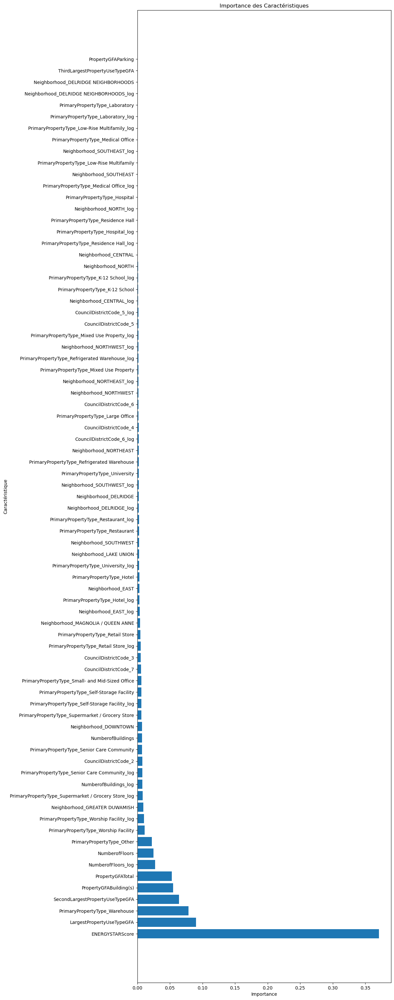

In [82]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor

def visualize_feature_importance(df, target_column, exclude_cols=[]):
    # Vérifier si les colonnes dans la liste d'exclusion existent dans le DataFrame
    for col in exclude_cols.copy():
        if col not in df.columns:
            print(f"La colonne '{col}' n'existe pas dans le DataFrame. Elle sera ignorée.")
            exclude_cols.remove(col)

    # Supprimer les colonnes exclues du DataFrame
    df_filtered = df.drop(exclude_cols, axis=1)

    # Extraire les colonnes de caractéristiques
    feature_columns = df_filtered.drop(target_column, axis=1)

    # Extraire la colonne cible
    target = df_filtered[target_column]

    # Initialiser et entraîner un modèle de Random Forest
    model = RandomForestRegressor(n_estimators=100, random_state=42)
    model.fit(feature_columns, target)

    # Obtenir l'importance des caractéristiques à partir du modèle entraîné
    feature_importances = model.feature_importances_

    # Créer un DataFrame pour stocker les noms des caractéristiques et leurs importances
    importance_df = pd.DataFrame({'Caractéristique': feature_columns.columns, 'Importance': feature_importances})

    # Trier les caractéristiques par importance en ordre décroissant
    importance_df = importance_df.sort_values(by='Importance', ascending=False)
    
    # Afficher les caractéristiques importantes
    print(importance_df)

    # Tracer un graphique des caractéristiques importantes
    plt.figure(figsize=(10, len(importance_df) / 2))
    plt.barh(importance_df['Caractéristique'], importance_df['Importance'])
    plt.xlabel('Importance')
    plt.ylabel('Caractéristique')
    plt.title('Importance des Caractéristiques')
    plt.show()

# Appelez la fonction avec votre DataFrame, la colonne cible et la liste d'exclusion mise à jour
exclude = ['DataYear',
 'Latitude',
 'Longitude',
 'YearBuilt',
 'SourceEUI(kBtu/sf)',
 'SourceEUIWN(kBtu/sf)',
 'GHGEmissionsIntensity',
 'SiteEnergyUse(kBtu)_per_sqf',
 'SiteEnergyUseWN(kBtu)_per_sqf',
 'SteamUse(kBtu)_per_sqf',
 'Electricity(kBtu)_per_sqf',
 'NaturalGas(therms)_per_sqf',
 'NaturalGas(kBtu)_per_sqf',
 'TotalGHGEmissions_per_sqf']

# Appelez la fonction en passant le DataFrame 'feat_important', la colonne cible ('SiteEUIWN(kBtu/sf)')
# et la liste d'exclusion des colonnes non souhaitées ('exclude')
visualize_feature_importance(feat_important, 'SiteEUIWN(kBtu/sf)', exclude_cols=exclude)


In [69]:
import numpy as np
from scipy.stats import skew
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline

# Créer un transformateur personnalisé pour appliquer le logarithme aux colonnes avec un coefficient d'asymétrie élevé
class SkewLogTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, skew_threshold=3):
        self.skew_threshold = skew_threshold
    
    def fit(self, X, y=None):
        self.skewness_dict = {}
        numeric_columns = X.select_dtypes(include=[np.number]).columns
        for col in numeric_columns:
            skewness = skew(X[col])
            self.skewness_dict[col] = skewness
        return self
    
    def transform(self, X, y=None):
        X_transformed = X.copy()
        for col, skew_val in self.skewness_dict.items():
            if abs(skew_val) > self.skew_threshold:
                X_transformed[col + '_log'] = np.log1p(X_transformed[col])
                X_transformed.drop(col, axis=1, inplace=True)
        return X_transformed

# Créez une pipeline
skew_log_pipeline = Pipeline([
    ('skew_log_transform', SkewLogTransformer(skew_threshold=3))
])

# Sélectionner uniquement les colonnes numériques à l'exclusion de 'Longitude' et 'Latitude'
numeric_columns = feat_important.drop(['Longitude', 'Latitude'], axis=1).select_dtypes(include=[np.number]).columns

# Calculez les coefficients d'asymétrie avant la transformation
skewness_dict_before = {}
for col in numeric_columns:
    skewness = skew(feat_important[col])
    skewness_dict_before[col] = skewness

# Appliquez la transformation logarithmique aux données
feat_important_log = skew_log_pipeline.fit_transform(feat_important[numeric_columns])

# Intégrer les variables transformées dans le DataFrame df
for col in feat_important_log.columns:
    feat_important[col] = feat_important_log[col]

# Afficher les coefficients d'asymétrie avant la transformation
print("\nCoefficient d'asymétrie avant la transformation :")
for col, skew_val in skewness_dict_before.items():
    print(f"Colonne : {col}, Coefficient d'asymétrie : {skew_val}")

# Calculer le coefficient d'asymétrie pour les colonnes après transformation
skewness_dict_after = {}
for col in feat_important_log.columns:
    if '_log' in col:
        skewness_dict_after[col] = abs(skew(feat_important_log[col]))  # Appliquer abs() ici

# Afficher les coefficients d'asymétrie après la transformation en valeur absolue
print("\nCoefficient d'asymétrie après la transformation (en valeur absolue) :")
for col, skew_val in skewness_dict_after.items():
    print(f"Colonne (après transformation logarithmique) : {col}, Coefficient d'asymétrie : {skew_val}")

# Afficher les données transformées
print("\nDonnées transformées :")
feat_important_log.head()


Coefficient d'asymétrie avant la transformation :
Colonne : DataYear, Coefficient d'asymétrie : nan
Colonne : YearBuilt, Coefficient d'asymétrie : -0.2792850607280555
Colonne : NumberofBuildings, Coefficient d'asymétrie : 8.455158655193012
Colonne : NumberofFloors, Coefficient d'asymétrie : 5.679812800464389
Colonne : PropertyGFATotal, Coefficient d'asymétrie : 1.2824153432072825
Colonne : PropertyGFAParking, Coefficient d'asymétrie : nan
Colonne : PropertyGFABuilding(s), Coefficient d'asymétrie : 1.2648123205166026
Colonne : LargestPropertyUseTypeGFA, Coefficient d'asymétrie : 1.2824193107381132
Colonne : SecondLargestPropertyUseTypeGFA, Coefficient d'asymétrie : 1.8093663951944434
Colonne : ThirdLargestPropertyUseTypeGFA, Coefficient d'asymétrie : nan
Colonne : ENERGYSTARScore, Coefficient d'asymétrie : -0.8904922310140224
Colonne : SiteEUIWN(kBtu/sf), Coefficient d'asymétrie : 0.8555031883464267
Colonne : SourceEUI(kBtu/sf), Coefficient d'asymétrie : 0.7119510728936584
Colonne : So

,DataYear,YearBuilt,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),GHGEmissionsIntensity,SiteEnergyUse(kBtu)_per_sqf,SiteEnergyUseWN(kBtu)_per_sqf,SteamUse(kBtu)_per_sqf,Electricity(kBtu)_per_sqf,NaturalGas(therms)_per_sqf,NaturalGas(kBtu)_per_sqf,TotalGHGEmissions_per_sqf,PrimaryPropertyType_Large Office,PrimaryPropertyType_Other,PrimaryPropertyType_Small- and Mid-Sized Office,PrimaryPropertyType_Warehouse,CouncilDistrictCode_2,CouncilDistrictCode_3,CouncilDistrictCode_4,CouncilDistrictCode_7,Neighborhood_DOWNTOWN,Neighborhood_GREATER DUWAMISH,Neighborhood_LAKE UNION,Neighborhood_MAGNOLIA / QUEEN ANNE,NumberofBuildings_log,NumberofFloors_log,PrimaryPropertyType_Hospital_log,PrimaryPropertyType_Hotel_log,PrimaryPropertyType_K-12 School_log,PrimaryPropertyType_Laboratory_log,PrimaryPropertyType_Low-Rise Multifamily_log,PrimaryPropertyType_Medical Office_log,PrimaryPropertyType_Mixed Use Property_log,PrimaryPropertyType_Refrigerated Warehouse_log,PrimaryPropertyType_Residence Hall_log,PrimaryPropertyType_Restaurant_log,PrimaryPropertyType_Retail Store_log,PrimaryPropertyType_Self-Storage Facility_log,PrimaryPropertyType_Senior Care Community_log,PrimaryPropertyType_Supermarket / Grocery Store_log,PrimaryPropertyType_University_log,PrimaryPropertyType_Worship Facility_log,CouncilDistrictCode_5_log,CouncilDistrictCode_6_log,Neighborhood_CENTRAL_log,Neighborhood_DELRIDGE_log,Neighborhood_DELRIDGE NEIGHBORHOODS_log,Neighborhood_EAST_log,Neighborhood_NORTH_log,Neighborhood_NORTHEAST_log,Neighborhood_NORTHWEST_log,Neighborhood_SOUTHEAST_log,Neighborhood_SOUTHWEST_log
0,2016.0,1927.0,88434.000000,0.0,88434.0,88434.000000,0.000000,0.0,60.0,84.300003,182.500000,189.000000,2.830000,81.714753,84.321754,0.0,44.621148,0.144340,14.433962,0.002827,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.693147,2.564949,0.0,0.693147,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2016.0,1996.0,103566.000000,0.0,88502.0,83880.000000,15064.000000,0.0,61.0,97.900002,176.100006,179.399994,2.860000,80.991184,83.661424,0.0,31.311924,0.496793,49.679258,0.002857,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.693147,2.484907,0.0,0.693147,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2016.0,1969.0,55634.533333,0.0,64383.6,65628.733333,0.000000,0.0,43.0,97.699997,241.899994,244.100006,2.190000,75.919114,77.331177,0.0,51.800174,0.015624,1.562373,0.002185,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.693147,3.737670,0.0,0.693147,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2016.0,1926.0,61320.000000,0.0,61320.0,61320.000000,0.000000,0.0,56.0,113.300003,216.199997,224.000000,2.244667,110.805349,113.287679,0.0,45.155322,0.295371,29.537068,0.002244,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.693147,2.397895,0.0,0.693147,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2016.0,1980.0,175580.000000,0.0,113580.0,123445.000000,2454.866667,0.0,75.0,118.699997,211.399994,215.600006,2.880000,80.718795,83.474786,0.0,30.576414,0.501424,50.142374,0.002876,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.693147,2.944439,0.0,0.693147,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [70]:
feat_important.head()

,DataYear,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),GHGEmissionsIntensity,SiteEnergyUse(kBtu)_per_sqf,SiteEnergyUseWN(kBtu)_per_sqf,SteamUse(kBtu)_per_sqf,Electricity(kBtu)_per_sqf,NaturalGas(therms)_per_sqf,NaturalGas(kBtu)_per_sqf,TotalGHGEmissions_per_sqf,PrimaryPropertyType_Hospital,PrimaryPropertyType_Hotel,PrimaryPropertyType_K-12 School,PrimaryPropertyType_Laboratory,PrimaryPropertyType_Large Office,PrimaryPropertyType_Low-Rise Multifamily,PrimaryPropertyType_Medical Office,PrimaryPropertyType_Mixed Use Property,PrimaryPropertyType_Other,PrimaryPropertyType_Refrigerated Warehouse,PrimaryPropertyType_Residence Hall,PrimaryPropertyType_Restaurant,PrimaryPropertyType_Retail Store,PrimaryPropertyType_Self-Storage Facility,PrimaryPropertyType_Senior Care Community,PrimaryPropertyType_Small- and Mid-Sized Office,PrimaryPropertyType_Supermarket / Grocery Store,PrimaryPropertyType_University,PrimaryPropertyType_Warehouse,PrimaryPropertyType_Worship Facility,CouncilDistrictCode_2,CouncilDistrictCode_3,CouncilDistrictCode_4,CouncilDistrictCode_5,CouncilDistrictCode_6,CouncilDistrictCode_7,Neighborhood_CENTRAL,Neighborhood_DELRIDGE,Neighborhood_DELRIDGE NEIGHBORHOODS,Neighborhood_DOWNTOWN,Neighborhood_EAST,Neighborhood_GREATER DUWAMISH,Neighborhood_LAKE UNION,Neighborhood_MAGNOLIA / QUEEN ANNE,Neighborhood_NORTH,Neighborhood_NORTHEAST,Neighborhood_NORTHWEST,Neighborhood_SOUTHEAST,Neighborhood_SOUTHWEST,NumberofBuildings_log,NumberofFloors_log,PrimaryPropertyType_Hospital_log,PrimaryPropertyType_Hotel_log,PrimaryPropertyType_K-12 School_log,PrimaryPropertyType_Laboratory_log,PrimaryPropertyType_Low-Rise Multifamily_log,PrimaryPropertyType_Medical Office_log,PrimaryPropertyType_Mixed Use Property_log,PrimaryPropertyType_Refrigerated Warehouse_log,PrimaryPropertyType_Residence Hall_log,PrimaryPropertyType_Restaurant_log,PrimaryPropertyType_Retail Store_log,PrimaryPropertyType_Self-Storage Facility_log,PrimaryPropertyType_Senior Care Community_log,PrimaryPropertyType_Supermarket / Grocery Store_log,PrimaryPropertyType_University_log,PrimaryPropertyType_Worship Facility_log,CouncilDistrictCode_5_log,CouncilDistrictCode_6_log,Neighborhood_CENTRAL_log,Neighborhood_DELRIDGE_log,Neighborhood_DELRIDGE NEIGHBORHOODS_log,Neighborhood_EAST_log,Neighborhood_NORTH_log,Neighborhood_NORTHEAST_log,Neighborhood_NORTHWEST_log,Neighborhood_SOUTHEAST_log,Neighborhood_SOUTHWEST_log
0,2016.0,47.61220,-122.33799,1927.0,1.0,12.0,88434.000000,0.0,88434.0,88434.000000,0.000000,0.0,60.0,84.300003,182.500000,189.000000,2.830000,81.714753,84.321754,0.0,44.621148,0.144340,14.433962,0.002827,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.693147,2.564949,0.0,0.693147,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2016.0,47.61317,-122.33393,1996.0,1.0,11.0,103566.000000,0.0,88502.0,83880.000000,15064.000000,0.0,61.0,97.900002,176.100006,179.399994,2.860000,80.991184,83.661424,0.0,31.311924,0.496793,49.679258,0.002857,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.693147,2.484907,0.0,0.693147,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2016.0,47.61393,-122.33810,1969.0,1.0,41.0,55634.533333,0.0,64383.6,65628.733333,0.000000,0.0,43.0,97.699997,241.899994,244.100006,2.190000,75.919114,77.331177,0.0,51.800174,0.015624,1.562373,0.002185,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.693147,3.73

## FEATURE ENGINEERING

In [71]:
feat_engi = feat_important.copy()

In [72]:
#Importation des bibliothèques
import datetime

def process_dataframe(df):

    # Calculer l'âge des bâtiments en années 
    current_year = datetime.datetime.now().year 
    df['BuildingAge'] = df['DataYear'] - df['YearBuilt']

    # Définir les limites des tranches d'âge en utilisant np.linspace
    age_bins = np.linspace(0, 100, 12)  # Crée 11 tranches égales de 0 à 100 ans
    age_labels = ['0-9', '10-19', '20-29', '30-39', '40-49', '50-59', '60-69', '70-79', '80-89', '90-99', '100+']
    df['BuildingAgeGroup'] = pd.cut(df['BuildingAge'], bins=age_bins, labels=age_labels, right=False)

    # Supprimer les colonnes inutiles
    df.drop(['BuildingAgeGroup'], axis=1, inplace=True)


        
    # Calculer les pourcentages des plus grandes propriétés d'utilisation en fonction de la superficie totale
    property_use_columns = ['LargestPropertyUseTypeGFA', 'SecondLargestPropertyUseTypeGFA', 'ThirdLargestPropertyUseTypeGFA']
    for col in property_use_columns:
        df[f'{col}_Percentage'] = (df[col] / df['PropertyGFATotal']) * 100
        

    # Calculer la proportion d'espace de stationnement par rapport à la superficie totale
    df['ParkingProportion'] = df['PropertyGFAParking'] / df['PropertyGFATotal']
    

    # Liste des colonnes qui commencent par "Neighborhood"
    neighborhood_columns = [col for col in df.columns if col.startswith('Neighborhood_')]

    # Calculer la densité de bâtiments par quartier
    neighborhood_building_count = df[neighborhood_columns].sum()
    total_buildings = neighborhood_building_count.sum()
    neighborhood_building_density = neighborhood_building_count / total_buildings
       

    # Calculer la proportion pour les variables de consommation d'énergie en fonction du quartier.
    energy_columns = ['SiteEnergyUse(kBtu)_per_sqf', 'Electricity(kBtu)_per_sqf', 'NaturalGas(kBtu)_per_sqf']
    for col in energy_columns:
        for neighborhood_col in neighborhood_columns:
            df[f'{col}_prop_{neighborhood_col}'] = df[col] * df[neighborhood_col] / df['PropertyGFATotal']
            
    # Calculer le ratio entre la plus grande et la deuxième plus grande superficie d'utilisation
    df['Largest_to_Second_Largest_ratio'] = df['LargestPropertyUseTypeGFA'] / df['SecondLargestPropertyUseTypeGFA']
       
    # Calculer la somme des consommations d'énergie totales par mètre carré
    df['Total_EnergyUse_per_sqf'] = df['SiteEnergyUse(kBtu)_per_sqf'] + df['Electricity(kBtu)_per_sqf'] + df['NaturalGas(kBtu)_per_sqf']
    
    # Calculer la consommation d'énergie totale par mètre carré par espace de stationnement
    df['Total_EnergyUse_per_Parking'] = df['Total_EnergyUse_per_sqf'] / df['ParkingProportion']
    
    # Calculer la consommation d'énergie par mètre carré par espace de stationnement pour la consommation de site
    df['SiteEnergyUse_per_Parking'] = df['SiteEnergyUse(kBtu)_per_sqf'] / df['ParkingProportion']
    
    # Calculer le ratio entre la superficie du bâtiment et la superficie totale
    df['PropertyGFABuilding_ratio'] = df['PropertyGFABuilding(s)'] / df['PropertyGFATotal']
    
    # Remplacer toutes les valeurs "inf" par 0 dans le DataFrame
    df.replace([float('inf'), -float('inf')], 0, inplace=True)

    return df

# Appeler la fonction pour traiter le DataFrame
df_processed = process_dataframe(feat_engi)

# Afficher les premières lignes du DataFrame traité
df_processed.head()



,DataYear,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),GHGEmissionsIntensity,SiteEnergyUse(kBtu)_per_sqf,SiteEnergyUseWN(kBtu)_per_sqf,SteamUse(kBtu)_per_sqf,Electricity(kBtu)_per_sqf,NaturalGas(therms)_per_sqf,NaturalGas(kBtu)_per_sqf,TotalGHGEmissions_per_sqf,PrimaryPropertyType_Hospital,PrimaryPropertyType_Hotel,PrimaryPropertyType_K-12 School,PrimaryPropertyType_Laboratory,PrimaryPropertyType_Large Office,PrimaryPropertyType_Low-Rise Multifamily,PrimaryPropertyType_Medical Office,PrimaryPropertyType_Mixed Use Property,PrimaryPropertyType_Other,PrimaryPropertyType_Refrigerated Warehouse,PrimaryPropertyType_Residence Hall,PrimaryPropertyType_Restaurant,PrimaryPropertyType_Retail Store,PrimaryPropertyType_Self-Storage Facility,PrimaryPropertyType_Senior Care Community,PrimaryPropertyType_Small- and Mid-Sized Office,PrimaryPropertyType_Supermarket / Grocery Store,PrimaryPropertyType_University,PrimaryPropertyType_Warehouse,PrimaryPropertyType_Worship Facility,CouncilDistrictCode_2,CouncilDistrictCode_3,CouncilDistrictCode_4,CouncilDistrictCode_5,CouncilDistrictCode_6,CouncilDistrictCode_7,Neighborhood_CENTRAL,Neighborhood_DELRIDGE,Neighborhood_DELRIDGE NEIGHBORHOODS,Neighborhood_DOWNTOWN,Neighborhood_EAST,Neighborhood_GREATER DUWAMISH,Neighborhood_LAKE UNION,Neighborhood_MAGNOLIA / QUEEN ANNE,Neighborhood_NORTH,Neighborhood_NORTHEAST,Neighborhood_NORTHWEST,Neighborhood_SOUTHEAST,Neighborhood_SOUTHWEST,NumberofBuildings_log,NumberofFloors_log,PrimaryPropertyType_Hospital_log,PrimaryPropertyType_Hotel_log,PrimaryPropertyType_K-12 School_log,PrimaryPropertyType_Laboratory_log,PrimaryPropertyType_Low-Rise Multifamily_log,PrimaryPropertyType_Medical Office_log,PrimaryPropertyType_Mixed Use Property_log,PrimaryPropertyType_Refrigerated Warehouse_log,PrimaryPropertyType_Residence Hall_log,PrimaryPropertyType_Restaurant_log,PrimaryPropertyType_Retail Store_log,PrimaryPropertyType_Self-Storage Facility_log,PrimaryPropertyType_Senior Care Community_log,PrimaryPropertyType_Supermarket / Grocery Store_log,PrimaryPropertyType_University_log,PrimaryPropertyType_Worship Facility_log,CouncilDistrictCode_5_log,CouncilDistrictCode_6_log,Neighborhood_CENTRAL_log,Neighborhood_DELRIDGE_log,Neighborhood_DELRIDGE NEIGHBORHOODS_log,Neighborhood_EAST_log,Neighborhood_NORTH_log,Neighborhood_NORTHEAST_log,Neighborhood_NORTHWEST_log,Neighborhood_SOUTHEAST_log,Neighborhood_SOUTHWEST_log,BuildingAge,LargestPropertyUseTypeGFA_Percentage,SecondLargestPropertyUseTypeGFA_Percentage,ThirdLargestPropertyUseTypeGFA_Percentage,ParkingProportion,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_CENTRAL,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE NEIGHBORHOODS,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_DOWNTOWN,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_EAST,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_GREATER DUWAMISH,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_LAKE UNION,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_MAGNOLIA / QUEEN ANNE,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_NORTH,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_NORTHEAST,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_NORTHWEST,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_SOUTHEAST,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_SOUTHWEST,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_CENTRAL_log,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE_log,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE NEIGHBORHOODS_log,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_EAST_log,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_NORTH_log,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_NORTHEAST_log,SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_NORTHWEST_log,SiteEnergyUse(kBtu)_per_sqf_prop_Neigh

In [73]:
list(df_processed)

['DataYear',
 'Latitude',
 'Longitude',
 'YearBuilt',
 'NumberofBuildings',
 'NumberofFloors',
 'PropertyGFATotal',
 'PropertyGFAParking',
 'PropertyGFABuilding(s)',
 'LargestPropertyUseTypeGFA',
 'SecondLargestPropertyUseTypeGFA',
 'ThirdLargestPropertyUseTypeGFA',
 'ENERGYSTARScore',
 'SiteEUIWN(kBtu/sf)',
 'SourceEUI(kBtu/sf)',
 'SourceEUIWN(kBtu/sf)',
 'GHGEmissionsIntensity',
 'SiteEnergyUse(kBtu)_per_sqf',
 'SiteEnergyUseWN(kBtu)_per_sqf',
 'SteamUse(kBtu)_per_sqf',
 'Electricity(kBtu)_per_sqf',
 'NaturalGas(therms)_per_sqf',
 'NaturalGas(kBtu)_per_sqf',
 'TotalGHGEmissions_per_sqf',
 'PrimaryPropertyType_Hospital',
 'PrimaryPropertyType_Hotel',
 'PrimaryPropertyType_K-12 School',
 'PrimaryPropertyType_Laboratory',
 'PrimaryPropertyType_Large Office',
 'PrimaryPropertyType_Low-Rise Multifamily',
 'PrimaryPropertyType_Medical Office',
 'PrimaryPropertyType_Mixed Use Property',
 'PrimaryPropertyType_Other',
 'PrimaryPropertyType_Refrigerated Warehouse',
 'PrimaryPropertyType_Reside

In [74]:
features_to_exclude = ['DataYear',
 'Latitude',
 'Longitude',
 'YearBuilt',

 'SourceEUI(kBtu/sf)',
 'SourceEUIWN(kBtu/sf)',
 'GHGEmissionsIntensity',
 'SiteEnergyUse(kBtu)_per_sqf',
 'SiteEnergyUseWN(kBtu)_per_sqf',
 'SteamUse(kBtu)_per_sqf',
 'Electricity(kBtu)_per_sqf',
 'NaturalGas(therms)_per_sqf',
 'NaturalGas(kBtu)_per_sqf',
 'TotalGHGEmissions_per_sqf',
 
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_CENTRAL',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE NEIGHBORHOODS',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_DOWNTOWN',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_EAST',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_GREATER DUWAMISH',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_LAKE UNION',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_MAGNOLIA / QUEEN ANNE',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_NORTH',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_NORTHEAST',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_NORTHWEST',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_SOUTHEAST',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_SOUTHWEST',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_CENTRAL_log',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE_log',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE NEIGHBORHOODS_log',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_EAST_log',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_NORTH_log',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_NORTHEAST_log',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_NORTHWEST_log',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_SOUTHEAST_log',
 'SiteEnergyUse(kBtu)_per_sqf_prop_Neighborhood_SOUTHWEST_log',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_CENTRAL',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE NEIGHBORHOODS',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_DOWNTOWN',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_EAST',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_GREATER DUWAMISH',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_LAKE UNION',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_MAGNOLIA / QUEEN ANNE',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_NORTH',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_NORTHEAST',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_NORTHWEST',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_SOUTHEAST',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_SOUTHWEST',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_CENTRAL_log',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE_log',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE NEIGHBORHOODS_log',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_EAST_log',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_NORTH_log',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_NORTHEAST_log',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_NORTHWEST_log',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_SOUTHEAST_log',
 'Electricity(kBtu)_per_sqf_prop_Neighborhood_SOUTHWEST_log',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_CENTRAL',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE NEIGHBORHOODS',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_DOWNTOWN',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_EAST',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_GREATER DUWAMISH',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_LAKE UNION',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_MAGNOLIA / QUEEN ANNE',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_NORTH',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_NORTHEAST',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_NORTHWEST',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_SOUTHEAST',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_SOUTHWEST',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_CENTRAL_log',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE_log',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_DELRIDGE NEIGHBORHOODS_log',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_EAST_log',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_NORTH_log',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_NORTHEAST_log',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_NORTHWEST_log',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_SOUTHEAST_log',
 'NaturalGas(kBtu)_per_sqf_prop_Neighborhood_SOUTHWEST_log',
 'Total_EnergyUse_per_sqf',
 'Total_EnergyUse_per_Parking',
 'SiteEnergyUse_per_Parking',]

                                      Caractéristique  Importance
8                                     ENERGYSTARScore    0.343925
27                      PrimaryPropertyType_Warehouse    0.078092
5                           LargestPropertyUseTypeGFA    0.059911
77                                        BuildingAge    0.050969
78               LargestPropertyUseTypeGFA_Percentage    0.050818
82                    Largest_to_Second_Largest_ratio    0.040102
4                              PropertyGFABuilding(s)    0.035563
2                                    PropertyGFATotal    0.035226
79         SecondLargestPropertyUseTypeGFA_Percentage    0.026588
6                     SecondLargestPropertyUseTypeGFA    0.024507
1                                      NumberofFloors    0.021736
17                          PrimaryPropertyType_Other    0.020578
49                                 NumberofFloors_log    0.019879
83                          PropertyGFABuilding_ratio    0.014244
65        

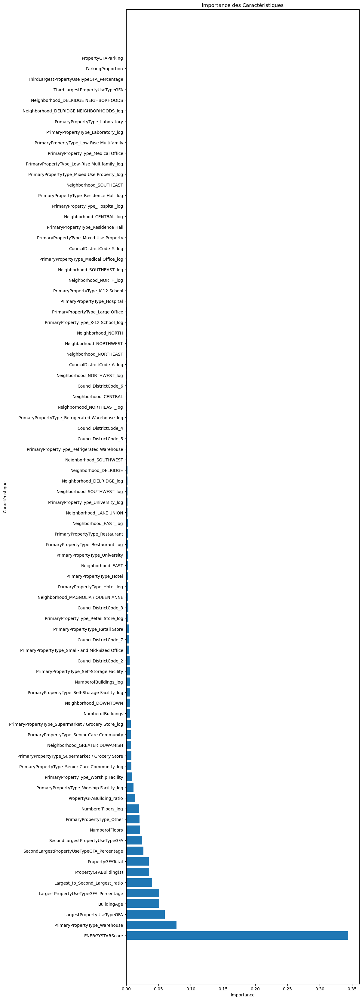

In [75]:
visualize_feature_importance(df_processed, 'SiteEUIWN(kBtu/sf)', exclude_cols=features_to_exclude)


In [103]:
# Nombre d'observations dans le DataFrame original
total_data = data.shape[0]

# Nombre d'observations après avoir retiré les outliers
remaining_data = df_processed.shape[0]

# Calcul du pourcentage
percentage_remaining = (remaining_data / total_data) * 100

# Affichage
print(f"Nombre d'observations total : {total_data}")
print(f"Nombre d'observations restant après le nettoyage des données : {remaining_data}")
print(f"Pourcentage d'observations restantes : {percentage_remaining:.2f}%")

# Nombre de colonnes dans le DataFrame original
total_colonnes = data.shape[1]

# Nombre de colonnes après avoir retiré les outliers
colonnes_nettoyees = df_processed.shape[1]

# Calcul du nombre de colonnes ajoutées
colonnes_ajoutees = colonnes_nettoyees - total_colonnes

# Affichage
print(f"\nColonnes    : \nNombre de colonnes dans le DataFrame original : {total_colonnes}")
print(f"Nombre de colonnes restantes après le nettoyage des données : {colonnes_nettoyees}")
print(f"Nombre de colonnes ajoutées : {colonnes_ajoutees}")



Nombre d'observations total : 3376
Nombre d'observations restant après le nettoyage des données : 1514
Pourcentage d'observations restantes : 44.85%

Colonnes    : 
Nombre de colonnes dans le DataFrame original : 46
Nombre de colonnes restantes après le nettoyage des données : 168
Nombre de colonnes ajoutées : 122


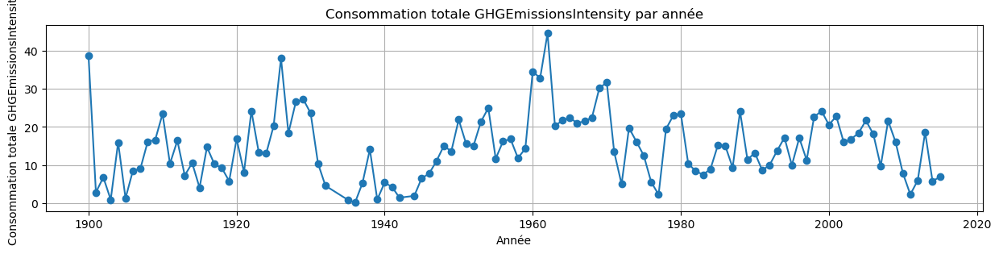

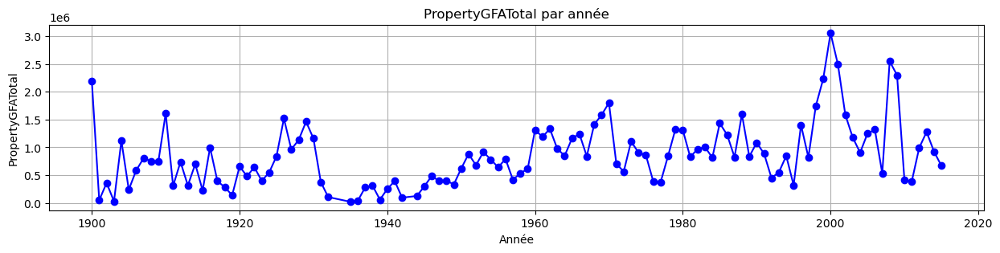

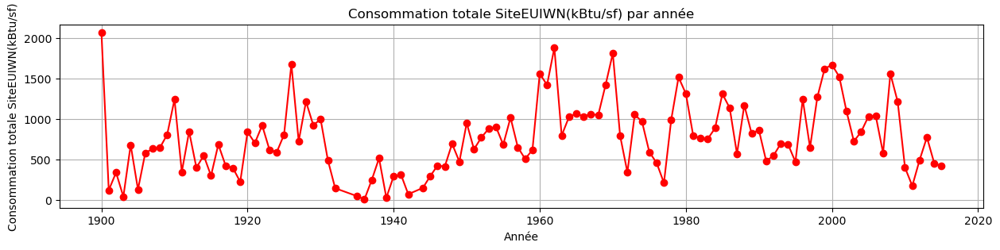

In [59]:
import matplotlib.pyplot as plt

# Agréger la consommation totale par année pour GHGEmissionsIntensity
GHGEmissions_totale_par_annee = df_processed.groupby('YearBuilt')['GHGEmissionsIntensity'].sum()

# Créer un graphique pour GHGEmissionsIntensity
plt.figure(figsize=(15, 3))
plt.plot(GHGEmissions_totale_par_annee.index, GHGEmissions_totale_par_annee.values, marker='o', linestyle='-')
plt.xlabel('Année')
plt.ylabel('Consommation totale GHGEmissionsIntensity')
plt.title('Consommation totale GHGEmissionsIntensity par année')
plt.grid(True)

# Afficher le premier graphique
plt.show()

# Créez un sous-ensemble du DataFrame avec les colonnes nécessaires
subset_df = df_processed[['YearBuilt', 'PropertyGFATotal']]

# Groupez les données par année et calculez la somme
grouped_data = subset_df.groupby('YearBuilt').sum()

# Obtenez les années et les valeurs de PropertyGFATotal
years = grouped_data.index
propertyGFA = grouped_data['PropertyGFATotal']

# Créer un graphique pour PropertyGFATotal
plt.figure(figsize=(15, 3))
plt.plot(years, propertyGFA, marker='o', linestyle='-', color='b')

plt.xlabel('Année')
plt.ylabel('PropertyGFATotal')
plt.title('PropertyGFATotal par année')
plt.grid(True)

# Afficher le deuxième graphique
plt.show()

# Agréger la consommation totale par année pour SiteEUIWN(kBtu/sf)
SiteEUIWN_totale_par_annee = df_processed.groupby('YearBuilt')['SiteEUIWN(kBtu/sf)'].sum()

# Créer un graphique pour SiteEUIWN(kBtu/sf)
plt.figure(figsize=(15, 3))
plt.plot(SiteEUIWN_totale_par_annee.index, SiteEUIWN_totale_par_annee.values, color='r', marker='o', linestyle='-')
plt.xlabel('Année')
plt.ylabel('Consommation totale SiteEUIWN(kBtu/sf)')
plt.title('Consommation totale SiteEUIWN(kBtu/sf) par année')
plt.grid(True)

# Afficher le troisième graphique
plt.show()

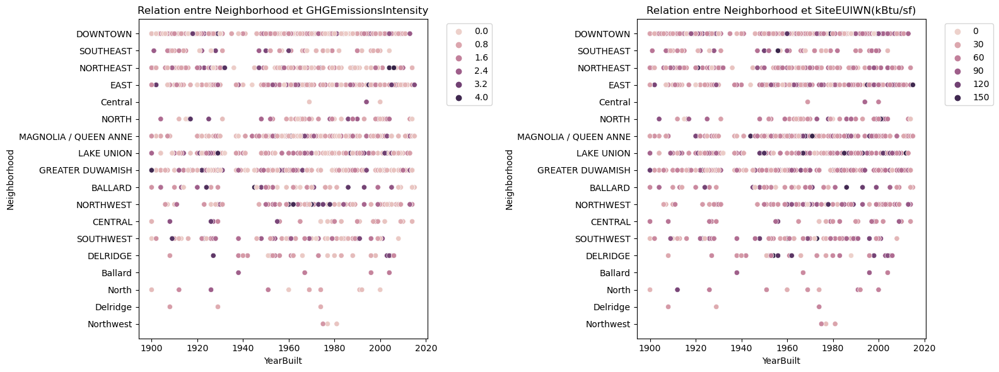

In [60]:
# Créer la première figure avec les scatter plots côte à côte
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Scatter plot pour GHGEmissionsIntensity
sns.scatterplot(y=df['Neighborhood'], x='YearBuilt', hue='GHGEmissionsIntensity', data=df_processed, ax=axes[0])
axes[0].set_title('Relation entre Neighborhood et GHGEmissionsIntensity')
axes[0].legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Scatter plot pour SiteEUIWN(kBtu)
sns.scatterplot(y=df['Neighborhood'], x='YearBuilt', hue='SiteEUIWN(kBtu/sf)', data=df_processed, ax=axes[1])
axes[1].set_title('Relation entre Neighborhood et SiteEUIWN(kBtu/sf)')
axes[1].legend(bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()


In [61]:
import folium
import folium.plugins

# Créer une carte centrée sur la moyenne des latitudes et longitudes
latitude_mean = df_processed['Latitude'].mean()
longitude_mean = df_processed['Longitude'].mean()
seattle_map = folium.Map(location=[latitude_mean, longitude_mean], zoom_start=11)

# Créer un cluster de marqueurs
marker_cluster = folium.plugins.MarkerCluster().add_to(seattle_map)

# Définir une échelle de couleur en fonction de la consommation
min_consumption = df_processed['SiteEUIWN(kBtu/sf)'].min()
max_consumption = df_processed['SiteEUIWN(kBtu/sf)'].max()
color_scale = folium.LinearColormap(['green', 'yellow', 'red'], vmin=min_consumption, vmax=max_consumption)

# Ajouter des marqueurs aux clusters avec la couleur en fonction de la consommation
for lat, lng, consumption in zip(df_processed.Latitude, df_processed.Longitude, df_processed['SiteEUIWN(kBtu/sf)']):
    folium.Marker(location=[lat, lng], icon=folium.Icon(color=color_scale(consumption))).add_to(marker_cluster)

# Ajouter la légende de la couleur
color_scale.add_to(seattle_map)

# Afficher la carte
seattle_map


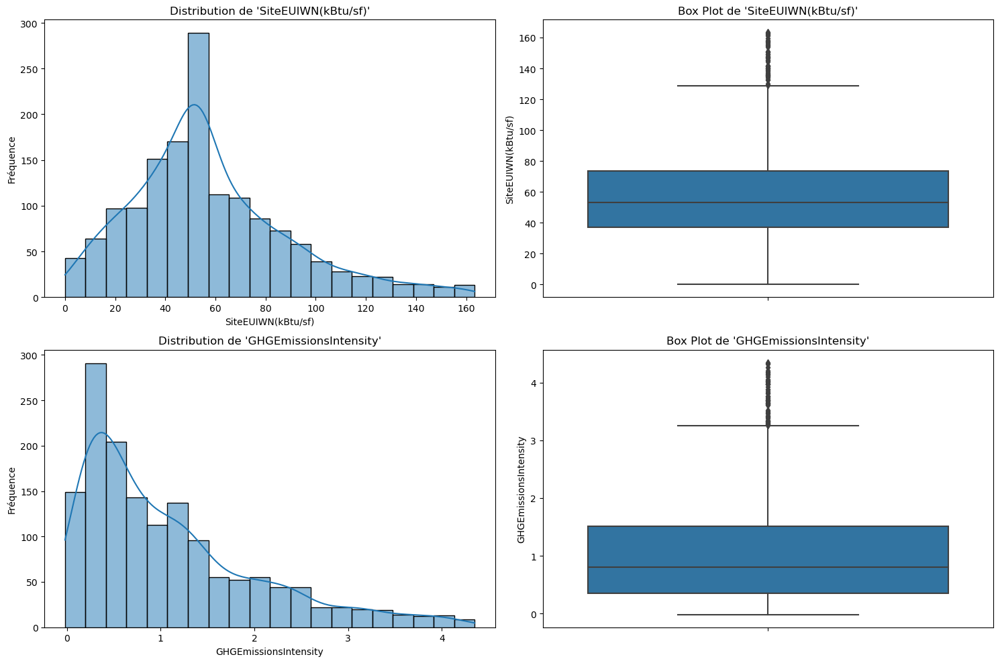

In [62]:
# Créer une figure avec plusieurs sous-graphiques (2 lignes, 2 colonnes)
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15, 10))

# Analyse de 'SiteEnergyUse(kBtu)'

# Histogramme
sns.histplot(df_processed['SiteEUIWN(kBtu/sf)'], bins=20, kde=True, ax=axes[0, 0])
axes[0, 0].set_title("Distribution de 'SiteEUIWN(kBtu/sf)'")
axes[0, 0].set_xlabel("SiteEUIWN(kBtu/sf)")
axes[0, 0].set_ylabel("Fréquence")

# Box Plot pour 'SiteEUIWN(kBtu/sf)'
sns.boxplot(y=df_processed['SiteEUIWN(kBtu/sf)'], ax=axes[0, 1])
axes[0, 1].set_title("Box Plot de 'SiteEUIWN(kBtu/sf)'")
axes[0, 1].set_ylabel("SiteEUIWN(kBtu/sf)")

# Analyse de 'TotalGHGEmissions'

# Histogramme
sns.histplot(df_processed['GHGEmissionsIntensity'], bins=20, kde=True, ax=axes[1, 0])
axes[1, 0].set_title("Distribution de 'GHGEmissionsIntensity'")
axes[1, 0].set_xlabel("GHGEmissionsIntensity")
axes[1, 0].set_ylabel("Fréquence")

# Box Plot pour 'GHGEmissionsIntensity'
sns.boxplot(y=df_processed['GHGEmissionsIntensity'], ax=axes[1, 1])
axes[1, 1].set_title("Box Plot de 'GHGEmissionsIntensity'")
axes[1, 1].set_ylabel("GHGEmissionsIntensity")

# Ajuster les espacements entre les sous-graphiques
plt.tight_layout()
plt.show()


# 

# ENREGISTREMENT

In [63]:
import pickle

# Enregistrez les données dans un fichier pickle
fichier_pickle = "donnees.pickle"
with open(fichier_pickle, 'wb') as f:
    pickle.dump(df_processed, f)

print("Données enregistrées dans", fichier_pickle)


Données enregistrées dans donnees.pickle
